<a href="https://colab.research.google.com/github/aviya-gmara/medical-data-analysis-and-ML/blob/main/CKD%20Prediction%20-%20Machine%20Learning%20In%20Medicine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from scipy.stats import chi2_contingency
import scipy.stats as stats
from scipy.stats import ttest_ind

In [ ]:


url = "https://github.com/aviya-gmara/medical-data-analysis-and-ML/raw/main/CKD%20dataset.xlsx"

# Read the Excel file into a pandas DataFrame
df = pd.read_excel(url)

# Display the DataFrame
df.head()


,StudyID,Gender,AgeBaseline,Age.3.categories,HistoryDiabetes,HistoryCHD,HistoryVascular,HistorySmoking,HistoryHTN,HistoryDLD,...,CholesterolBaseline,TriglyceridesBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,dBPBaseline,BMIBaseline,TimeToEventMonths,EventCKD35
0,1,0,64,1,0,0,0,0,1,1,...,4.8,0.92,5.90,59.0,93.319050,144,87,40.161842,98,0
1,2,0,52,1,0,0,0,0,1,1,...,6.4,1.84,6.00,52.0,105.833836,148,91,44.536941,106,0
2,3,0,56,1,0,0,0,0,1,1,...,6.4,1.75,5.90,57.0,99.839823,149,86,40.543437,88,0
3,4,0,58,1,0,0,0,0,0,1,...,5.1,1.22,5.50,65.0,90.315159,116,68,32.025584,103,0
4,5,0,63,1,1,0,0,0,1,1,...,5.0,1.11,7.46,70.0,79.725199,132,63,30.757401,105,0


In [ ]:
df.columns

Index(['StudyID', 'Gender', 'AgeBaseline', 'Age.3.categories',
       'HistoryDiabetes', 'HistoryCHD', 'HistoryVascular', 'HistorySmoking',
       'HistoryHTN ', 'HistoryDLD', 'HistoryObesity', 'DLDmeds', 'DMmeds',
       'HTNmeds', 'ACEIARB', 'CholesterolBaseline', 'TriglyceridesBaseline',
       'HgbA1C', 'CreatnineBaseline', 'eGFRBaseline', 'sBPBaseline',
       'dBPBaseline', 'BMIBaseline', 'TimeToEventMonths', 'EventCKD35'],
      dtype='object')

In [ ]:
df.shape

(491, 25)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 491 entries, 0 to 490
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   StudyID                491 non-null    int64  
 1   Gender                 491 non-null    int64  
 2   AgeBaseline            491 non-null    int64  
 3   Age.3.categories       491 non-null    int64  
 4   HistoryDiabetes        491 non-null    int64  
 5   HistoryCHD             491 non-null    int64  
 6   HistoryVascular        491 non-null    int64  
 7   HistorySmoking         491 non-null    int64  
 8   HistoryHTN             491 non-null    int64  
 9   HistoryDLD             491 non-null    int64  
 10  HistoryObesity         491 non-null    int64  
 11  DLDmeds                491 non-null    int64  
 12  DMmeds                 491 non-null    int64  
 13  HTNmeds                491 non-null    int64  
 14  ACEIARB                491 non-null    int64  
 15  Choles

# בשלב הראשון ראינו כי אין כמעט ערכים חסרים למעט ב
# Baseline Triglycerides and HbA1C columns
# השתמשנו במילוי הערך הממוצע של אותו פיצ'אר בכדי לשמור על אותה ההתפלגות

In [ ]:
for column in df.columns:
  if df[column].isnull().any():
    df[column].fillna(round(df[column].mean()), inplace=True)

# Print updated info
print("\nUpdated DataFrame info after filling missing values:\n")
df.info()


Updated DataFrame info after filling missing values:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 491 entries, 0 to 490
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   StudyID                491 non-null    int64  
 1   Gender                 491 non-null    int64  
 2   AgeBaseline            491 non-null    int64  
 3   Age.3.categories       491 non-null    int64  
 4   HistoryDiabetes        491 non-null    int64  
 5   HistoryCHD             491 non-null    int64  
 6   HistoryVascular        491 non-null    int64  
 7   HistorySmoking         491 non-null    int64  
 8   HistoryHTN             491 non-null    int64  
 9   HistoryDLD             491 non-null    int64  
 10  HistoryObesity         491 non-null    int64  
 11  DLDmeds                491 non-null    int64  
 12  DMmeds                 491 non-null    int64  
 13  HTNmeds                491 non-null    int64  
 14  ACE



---

# לאחר הטיפול בערכים החסרים עברנו להתחיל לסקור את המשתנים השונם


In [ ]:
df['EventCKD35'].value_counts()

EventCKD35
0    435
1     56
Name: count, dtype: int64

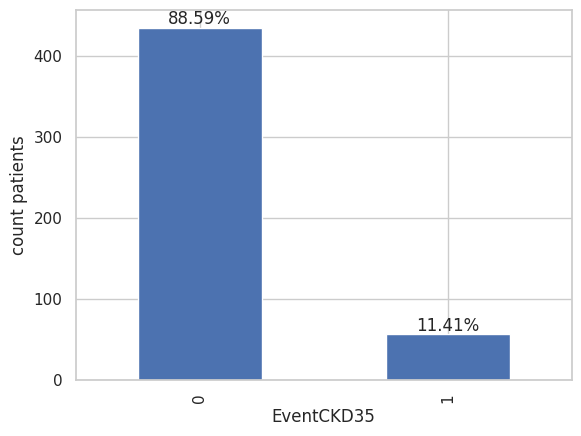

In [ ]:

import matplotlib.pyplot as plt
# Create a bar chart of the target variable distribution
df['EventCKD35'].value_counts().plot(kind='bar')

# Add labels to the bars
for i, value in enumerate(df['EventCKD35'].value_counts()):
    plt.text(i, value, str(round(value / len(df) * 100, 2)) + '%', ha='center', va='bottom')

# Set the y-axis scale to percentages
plt.ylabel('count patients')

# Display the chart
plt.show()



> מספר האנשים שחולים ב CKD

>מהווה אחוז הנמוך מכלל האוכלוסיה בדאטה


---



## ננסה להבין על סמך הפיצארים השונים מה עשוי להיות גורם מסביר למחלה


## Feature analysis

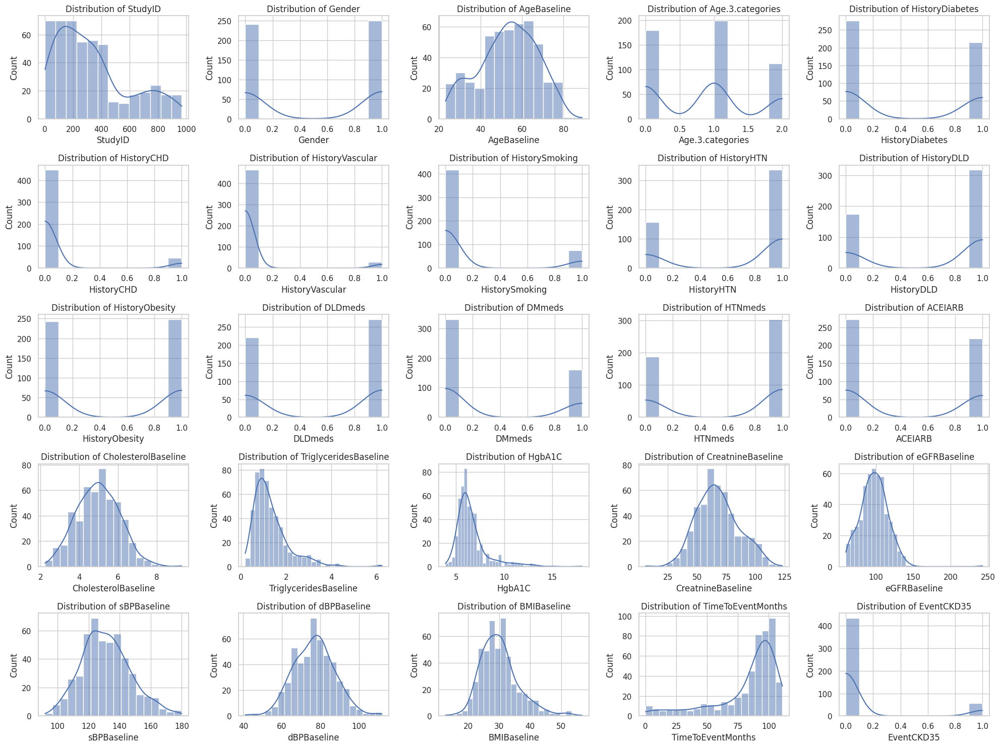

In [ ]:

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# List of numerical columns
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns.tolist()

# Plot histograms for numerical columns
plt.figure(figsize=(20, 15))
for i, col in enumerate(numerical_columns):
    plt.subplot(5, 5, i + 1)
    sns.histplot(df[col], kde=True)
    plt.title(f'Distribution of {col}')
plt.tight_layout()
plt.show()


### נסינו לבחון את ההתפלגויות הכלליות של המטופלים ולראות הא יש ערכים חרגים ולאיזה התפלגות סטטסטית רוב המדדים מתכנסים


---


## נמשיך לבחון את ההתפלגויות ביחס למשתנה המטרה

### התפלגויות ביחס למשתנה המטרה

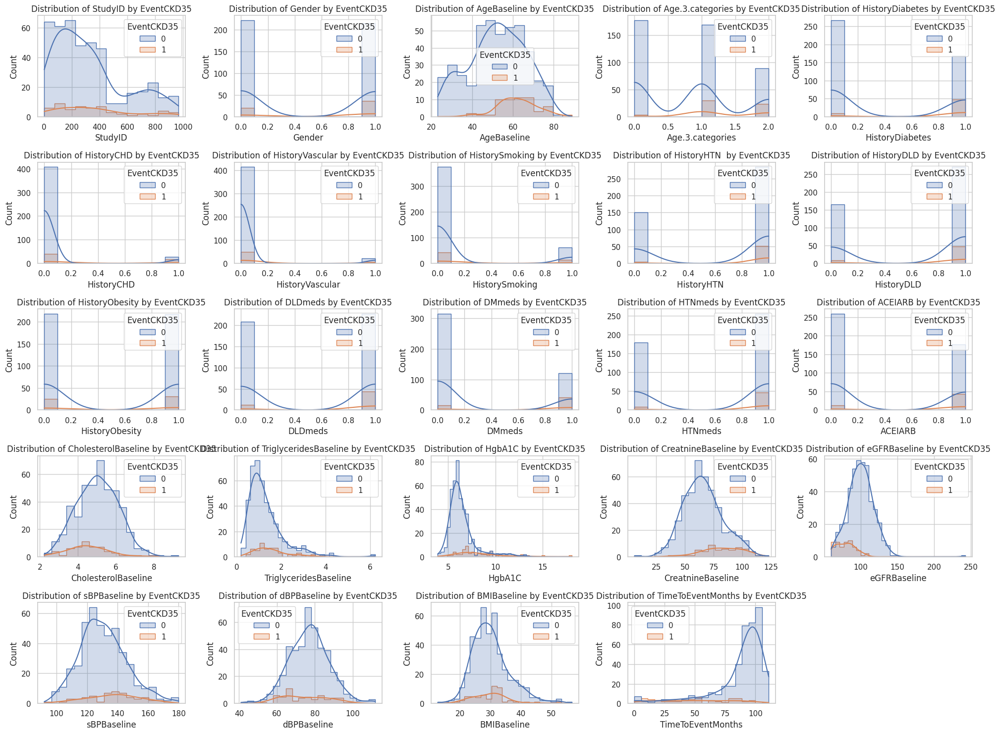

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# List of numerical columns
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns.tolist()
numerical_columns.remove('EventCKD35')  # Remove target variable from numerical columns

# Plot histograms for numerical columns with hue for target variable
plt.figure(figsize=(20, 15))
for i, col in enumerate(numerical_columns):
    plt.subplot(5, 5, i + 1)
    sns.histplot(df, x=col, hue='EventCKD35', kde=True, element='step')
    plt.title(f'Distribution of {col} by EventCKD35')
plt.tight_layout()
plt.show()

# מסקנות:
* **גיל** משפיע על הסיכוי במחלה
* **המגדר** שנוטה לחלות יותר במחלה הוא **נשים**
* **סוכרת** משפיעה על על הסיכוי לחלות
* היסטורה של יתר לחץ גם משפיעה אל הסיכוי לחלות **HTN**
* **ACETARB** גם משפיעה על הסיכוי למחלקה
> גם **DLD** משפיעה על הסיכוי לחללות כי זה קשור לשומנים  **History DLD** היסטוריה של דיסליפידמיה. שינויים ברמות השומנים בדם קשורים לסיכון למחלות כליות.
*כל אינפורציה על מחלה שמטופל לוקח   מצביעה על סיכוי גבוהה יותר לחלות במחלה **meds**
* מטופל שלוקח את התרופה הזו נוטה יותר לחלות במחלה **ACETARB**

**משתנים נומריים**:


- **HgbA1C**: ערכי ה-HgbA1C מראים הבדל ברור יותר בין הקבוצות. אלו עם CKD נוטים לערכים גבוהים יותר, מה שמעיד על קשר אפשרי בין ערכי סוכר גבוהים יותר בדם לבין CKD.

- **CreatnineBaseline**: ישנו הבדל ברור בין שתי הקבוצות, כאשר ערכי הקריאטינין גבוהים יותר בקבוצה עם CKD. זהו אינדיקטור חשוב למחלת כליות כרונית.

- **eGFRBaseline**: ערכי ה-eGFR נמוכים יותר בקבוצה עם CKD, מה שמעיד על תפקוד כלייתי ירוד יותר בקבוצה זו.

- **sBPBaseline** ו- **dBPBaseline**: נראה שישנה נטייה לערכים גבוהים יותר של לחץ דם סיסטולי ודיאסטולי בקבוצה עם CKD.

---



<ipython-input-78-943e02eb3104>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Age.3.categories', y='AgeBaseline', data=df, palette='Set2')


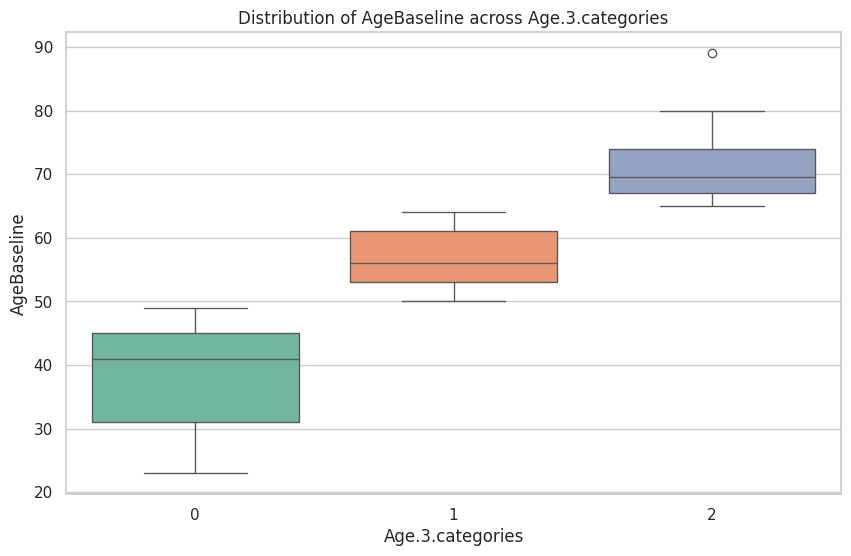

In [ ]:
# Set the style for the plots
sns.set(style="whitegrid")

# Create a boxplot with hue to show the distribution of AgeBaseline for each Age.3.categories
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age.3.categories', y='AgeBaseline', data=df, palette='Set2')

# Set plot labels and title
plt.xlabel('Age.3.categories')
plt.ylabel('AgeBaseline')
plt.title('Distribution of AgeBaseline across Age.3.categories')

# Display the plot
plt.show()



*   קבוצה 0 מייצגת יותר את הצערים, עד גיל 50
*   קבוצה 1 מייצגת את הגילאים בין 50  עד 65
* קבוצה 2 מייצגת את גיל 65 ומעלה כולל חריגה של מטופל אחד בגיל 90



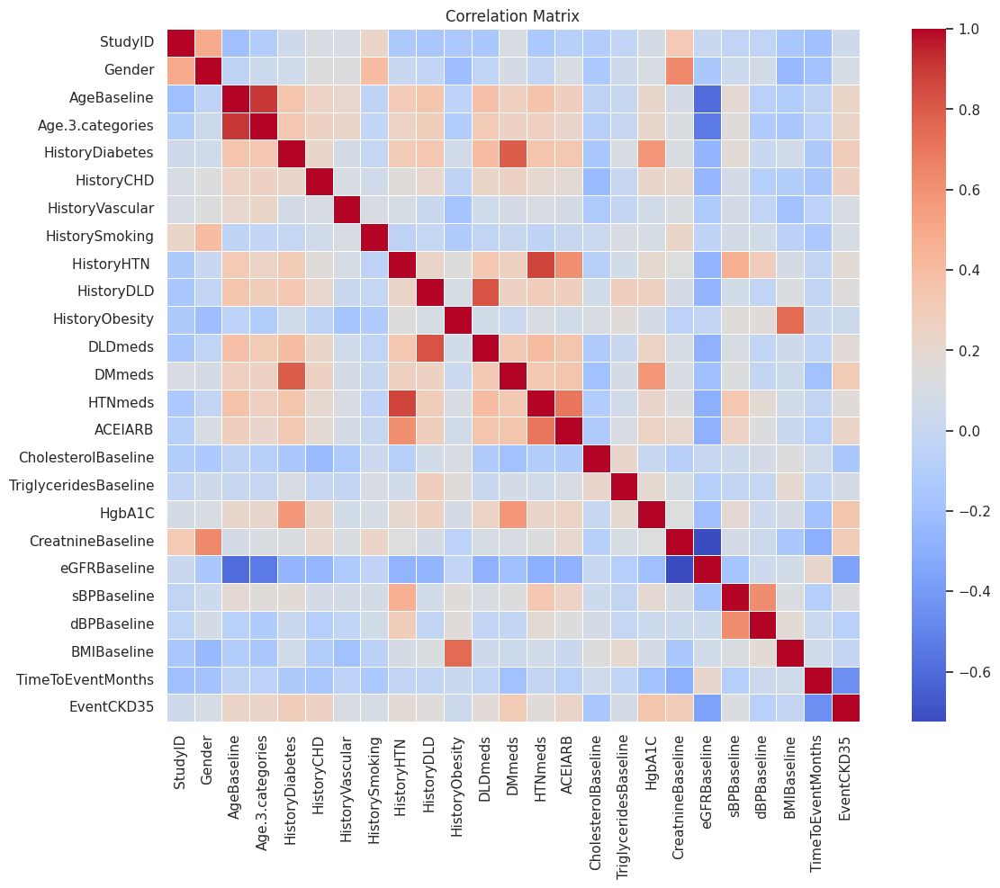

In [ ]:
# Calculate the correlation matrix
corr_matrix = df.corr()

# Set up the matplotlib figure
plt.figure(figsize=(15, 10))  # Set figsize to a larger size

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_matrix, cmap='coolwarm', square=True, linewidths=.5)
plt.title('Correlation Matrix')
plt.show()

### ניתוח מטריצת המתאם

הקשירים בין המשתנים במטריצה מספקים תובנות על חוזק וכיוון הקשר ביניהם:

- **מתאמים חיוביים חזקים**:
  - `AgeBaseline` ו-`Age.3.categories`: קטגוריות גיל מתואמות גבוה עם גיל המשתתפים.
  - `CreatnineBaseline` ו-`eGFRBaseline`: רמות קריאטינין גבוהות מתואמות עם eGFR נמוך.
  - `DMmeds` ו-`HistoryDiabetes`: שימוש בתרופות לסוכרת מתואם גבוה עם היסטוריה של סוכרת.
  - `HTNmeds` ו-`HistoryHTN`: שימוש בתרופות ללחץ דם גבוה מתואם עם היסטוריה של יתר לחץ דם.

- **מתאמים חיוביים בינוניים**:
  - `HistoryObesity` ו-`BMI`: היסטוריה של השמנה מתואמת עם מדד מסת גוף.
  - `DLDmeds` ו-`HistoryDLD`: שימוש בתרופות לדיסליפידמיה מתואם עם היסטוריה של דיסליפידמיה.
  - `ACEIARB` ו-`HistoryHTN`: שימוש ב-ACEI או ARB מתואם עם היסטוריה של יתר לחץ דם.

- **מתאמים שליליים**:
  - `eGFRBaseline` ו-`AgeBaseline`: ערכי eGFR נוטים לרדת עם העלייה בגיל.
  - `CreatnineBaseline` ו-`AgeBaseline`: רמות קריאטינין נוטות לעלות עם העלייה בגיל.

מטריצת המתאם מספקת תמונה על קשרים משמעותיים בין משתנים שונים, המסייעת להבנת הקשרים הבריאותיים והדמוגרפיים.

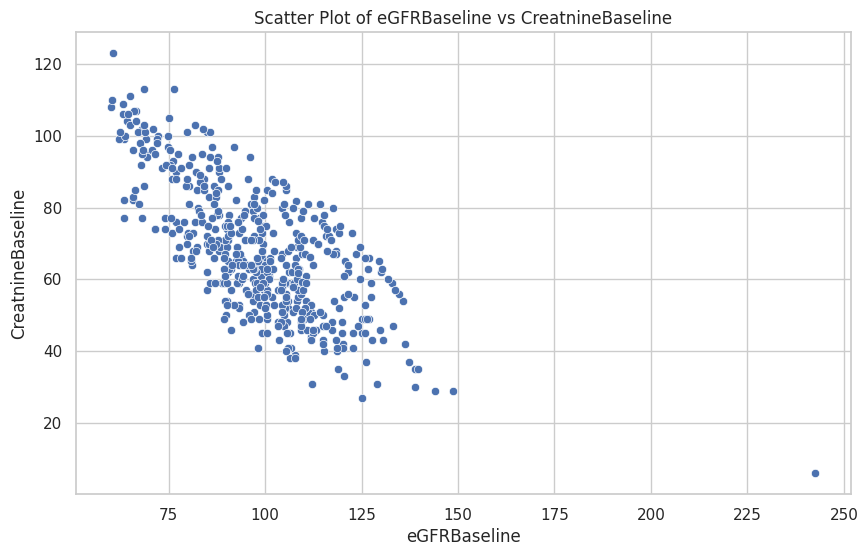

In [ ]:
numerical_df = df.select_dtypes(include=['float64'])



# Calculate the correlation matrix for numerical columns
corr_matrix = numerical_df.corr().abs()

# Find pairs of features with correlation greater than 0.6
high_corr_pairs = [(corr_matrix.columns[i], corr_matrix.columns[j])
                   for i in range(len(corr_matrix.columns))
                   for j in range(i) if corr_matrix.iloc[i, j] > 0.6]

# Plot scatter plots for each pair of highly correlated features
for pair in high_corr_pairs:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=numerical_df, x=pair[0], y=pair[1])
    plt.title(f'Scatter Plot of {pair[0]} vs {pair[1]}')
    plt.show()

### ניתוח גרף פיזור של eGFRBaseline ו-CreatnineBaseline

הגרף מציג את הקשר בין ערכי ה-eGFR בערכים הבסיסיים לבין רמות הקריאטינין בערכים הבסיסיים:

- **קשר שלילי חזק**: ניתן לראות קשר שלילי חזק בין שני המשתנים. ככל שערכי ה-eGFR גבוהים יותר, רמות הקריאטינין נמוכות יותר.
- **הבנה רפואית**: קשר זה הגיוני מבחינה רפואית, שכן eGFR הוא מדד לתפקוד כליות, וכאשר תפקוד הכליות טוב (eGFR גבוה), רמות הקריאטינין בדם נמוכות.

הגרף מדגיש את הקשר החשוב בין שני המדדים הללו בתפקוד הכליות ומאפשר זיהוי של חריגות אפשריות בערכים.


---
###  ננסה להבין קשרים עמוקים יותר בין המשתנים השונים ובין קבוצת משתנים אחת לאחרת


In [ ]:
import pandas as pd

# Calculate the correlation matrix
correlation_matrix = df.corr()

# Find the pairs with the highest correlation (absolute value)
correlation_pairs = correlation_matrix.unstack().sort_values(kind="quicksort", ascending=False)
high_corr_pairs = correlation_pairs[(correlation_pairs < 1) & (abs(correlation_pairs) > 0.6)]

# Display the high correlation pairs
high_corr_pairs

Age.3.categories   AgeBaseline          0.902552
AgeBaseline        Age.3.categories     0.902552
HTNmeds            HistoryHTN           0.866328
HistoryHTN         HTNmeds              0.866328
DLDmeds            HistoryDLD           0.822277
HistoryDLD         DLDmeds              0.822277
HistoryDiabetes    DMmeds               0.791391
DMmeds             HistoryDiabetes      0.791391
HistoryObesity     BMIBaseline          0.748524
BMIBaseline        HistoryObesity       0.748524
ACEIARB            HTNmeds              0.706798
HTNmeds            ACEIARB              0.706798
CreatnineBaseline  Gender               0.632526
Gender             CreatnineBaseline    0.632526
sBPBaseline        dBPBaseline          0.621846
dBPBaseline        sBPBaseline          0.621846
HistoryHTN         ACEIARB              0.612319
ACEIARB            HistoryHTN           0.612319
eGFRBaseline       CreatnineBaseline   -0.724609
CreatnineBaseline  eGFRBaseline        -0.724609
dtype: float64

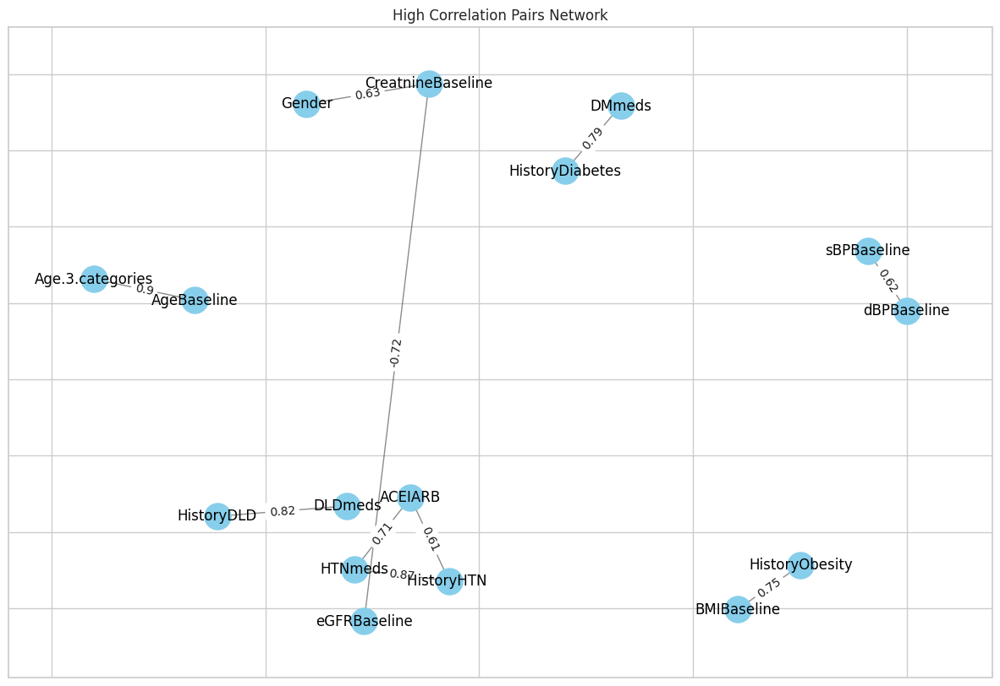

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a graph from the high correlation pairs
G = nx.Graph()

# Add edges to the graph for high correlation pairs
for (feature1, feature2), corr_value in high_corr_pairs.items():
    G.add_edge(feature1, feature2, weight=corr_value)

# Define positions for the nodes in the graph
pos = nx.spring_layout(G, k=0.5, iterations=50)

# Draw the graph
plt.figure(figsize=(15, 10))
nx.draw_networkx_nodes(G, pos, node_size=500, node_color='skyblue')
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=12, font_color='black')

# Draw edge labels (correlation values)
edge_labels = nx.get_edge_attributes(G, 'weight')
edge_labels = {k: round(v, 2) for k, v in edge_labels.items()}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title('High Correlation Pairs Network')
plt.show()

### ניתוח רשת קשרים חזקים

הגרף מציג את רשת הקשרים החזקים בין המשתנים השונים, עם ערכי המתאם ביניהם:

- **קשרים חזקים מאוד**:
  - `AgeBaseline` ו-`Age.3.categories` (0.9): גיל המשתתפים וקטגוריות הגיל מתואמים מאוד גבוה.
  - `HistoryDiabetes` ו-`DMmeds` (0.79): היסטוריה של סוכרת ושימוש בתרופות לסוכרת.
  - `HistoryDLD` ו-`DLDmeds` (0.82): היסטוריה של דיסליפידמיה ושימוש בתרופות לדיסליפידמיה.
  - `HistoryObesity` ו-`BMI` (0.75): היסטוריה של השמנה ומדד מסת גוף.
  - `HistoryHTN` ו-`HTNmeds` (0.68): היסטוריה של יתר לחץ דם ושימוש בתרופות ללחץ דם גבוה.

- **קשרים שליליים חזקים**:
  - `eGFRBaseline` ו-`CreatnineBaseline` (-0.72): מדדי תפקוד כליות ורמות קריאטינין בדם.

- **קשרים בינוניים**:
  - `sBPBaseline` ו-`dBPBaseline` (0.62): לחץ דם סיסטולי ודיאסטולי.

הגרף ממחיש את הקשרים המשמעותיים בין המשתנים, מה שמסייע להבנת ההקשרים הבריאותיים החשובים בניתוח הנתונים.



---

### לאחר שראינו כי קיימים קשרים שונים בין המשתנים היכולים להעיד על דפוסים שונים של רקע רפואי ננסה להבין האם הקשרים האלו רק מקיימים קורולציה מסוימת עם משתנה המטרה או שהם מובהקים סטטסית בהשפעה על סיכווי המטופל להיות חולה ב CKD
---



In [ ]:
categorical_columns = [
    'Gender', 'HistoryDiabetes', 'HistoryCHD', 'HistoryVascular',
    'HistorySmoking', 'HistoryHTN', 'HistoryDLD', 'HistoryObesity',
    'DLDmeds', 'DMmeds', 'HTNmeds', 'ACEIARB'
]

significant_vars = []
list_of_significant_vars= []
for col in categorical_columns:
    if col in df.columns:
        contingency_table = pd.crosstab(df[col], df['EventCKD35'])
        chi2, p, dof, expected = chi2_contingency(contingency_table)
        if p < 0.05:
            significant_vars.append((col, chi2, p))
            list_of_significant_vars.append(col)

# Print the results
print("Significantly associated variables with EventCKD35 at p < 0.05:")
for var, chi, p_val in significant_vars:
    print(f"{var}: Chi2 = {chi:.4f}, p-value = {p_val:.4e}")

Significantly associated variables with EventCKD35 at p < 0.05:
Gender: Chi2 = 3.9370, p-value = 4.7236e-02
HistoryDiabetes: Chi2 = 39.5567, p-value = 3.1867e-10
HistoryCHD: Chi2 = 31.2866, p-value = 2.2261e-08
HistoryDLD: Chi2 = 9.4284, p-value = 2.1365e-03
DLDmeds: Chi2 = 12.9223, p-value = 3.2469e-04
DMmeds: Chi2 = 44.8212, p-value = 2.1587e-11
HTNmeds: Chi2 = 12.1652, p-value = 4.8691e-04
ACEIARB: Chi2 = 25.0462, p-value = 5.5974e-07


In [ ]:
# Filter data for the two groups
group_0 = df[df['EventCKD35'] == 0]
group_1 = df[df['EventCKD35'] == 1]

# Define numerical columns to test
numerical_columns = [
    'AgeBaseline', 'Age.3.categories', 'CholesterolBaseline',
    'TriglyceridesBaseline', 'HgbA1C', 'CreatnineBaseline',
    'eGFRBaseline', 'sBPBaseline', 'dBPBaseline', 'BMIBaseline',
    'TimeToEventMonths'
]


# Perform t-tests and display results for variables with p-value < 0.05
significant_vars = []
for col in numerical_columns:
    if col in df.columns:
        t_stat, p_val = ttest_ind(group_0[col].dropna(), group_1[col].dropna())
        if p_val < 0.05:
            significant_vars.append((col, t_stat, p_val))
            list_of_significant_vars.append(col)

# Print the results
print("Significantly different variables at p < 0.05:")
for var, t_statistic, p_value in significant_vars:
    print(f"{var}: t-statistic = {t_statistic:.4f}, p-value = {p_value:.4e}")

Significantly different variables at p < 0.05:
AgeBaseline: t-statistic = -5.3371, p-value = 1.4478e-07
Age.3.categories: t-statistic = -5.3322, p-value = 1.4853e-07
CholesterolBaseline: t-statistic = 3.1787, p-value = 1.5728e-03
HgbA1C: t-statistic = -8.2407, p-value = 1.5828e-15
CreatnineBaseline: t-statistic = -6.9531, p-value = 1.1493e-11
eGFRBaseline: t-statistic = 8.5073, p-value = 2.1868e-16
sBPBaseline: t-statistic = -2.7321, p-value = 6.5213e-03
TimeToEventMonths: t-statistic = 11.1172, p-value = 9.4156e-26


# סיכום

בניתוח הנתונים זוהו מספר משתנים המראים הבדל מובהק סטטיסטית בין קבוצות ה-CKD (מחלת כליות כרונית):

## משתנים נומריים
- **AgeBaseline**: מראה הבדל מובהק סטטיסטית בין הקבוצות. גיל הוא גורם סיכון משמעותי למחלת כליות כרונית, עם סיכון גובר ככל שהגיל עולה.
- **Age.3.categories**: מראה הבדל מובהק סטטיסטית בין הקבוצות. קטגוריות גיל מסוימות עשויות להיות בעלות סיכון מוגבר ל-CKD.
- **CholesterolBaseline**: מראה הבדל מובהק סטטיסטית בין הקבוצות. רמות כולסטרול גבוהות עלולות לגרום לנזק לכליות.
- **HgbA1C**: מראה הבדל מובהק סטטיסטית בין הקבוצות. רמות גבוהות של HgbA1C מעידות על שליטה גרועה ברמות הסוכר בדם, מה שיכול להוביל לנזק לכליות.
- **CreatnineBaseline**: מראה הבדל מובהק סטטיסטית בין הקבוצות. רמות קריאטינין גבוהות מעידות על ירידה בתפקוד הכליות.
- **eGFRBaseline**: מראה הבדל מובהק סטטיסטית בין הקבוצות. eGFR נמוך מעיד על תפקוד כליות לקוי.
- **sBPBaseline**: מראה הבדל מובהק סטטיסטית בין הקבוצות. לחץ דם סיסטולי גבוה הוא גורם סיכון משמעותי ל-CKD.
- **TimeToEventMonths**: מראה הבדל מובהק סטטיסטית בין הקבוצות. הזמן עד לאירוע קשור בהתקדמות המחלה.

## משתנים קטגוריאליים
- **Gender**: מראה הבדל מובהק סטטיסטית בין הקבוצות. ידוע כי יש הבדלים במופע מחלת הכליות הכרונית בין גברים לנשים.
- **HistoryDiabetes**: מראה הבדל מובהק סטטיסטית בין הקבוצות. סוכרת היא אחד מגורמי הסיכון העיקריים למחלת כליות כרונית.
- **HistoryCHD**: מראה הבדל מובהק סטטיסטית בין הקבוצות. מחלות לב כליליות יכולות להשפיע על תפקוד הכליות.
- **HistoryHTN**: מראה הבדל מובהק סטטיסטית בין הקבוצות. לחץ דם גבוה הוא גורם סיכון ידוע ל-CKD.
- **HistoryDLD**: מראה הבדל מובהק סטטיסטית בין הקבוצות. דיסליפידמיה יכולה לתרום לנזק כלייתי.
- **DLDmeds**: מראה הבדל מובהק סטטיסטית בין הקבוצות. תרופות לטיפול בדיסליפידמיה יכולות להצביע על היסטוריה של מצבים שמשפיעים על הכליות.
- **DMmeds**: מראה הבדל מובהק סטטיסטית בין הקבוצות. תרופות לטיפול בסוכרת מצביעות על קיום סוכרת, שהיא גורם סיכון מרכזי ל-CKD.
- **HTNmeds**: מראה הבדל מובהק סטטיסטית בין הקבוצות. תרופות ללחץ דם גבוה מצביעות על היסטוריה של היפרטנסיה.
- **ACEIARB**: מראה הבדל מובהק סטטיסטית בין הקבוצות. תרופות אלו ידועות כמגנות על תפקוד הכליות ומשמשות לטיפול בלחץ דם גבוה ומצבי לב.


## מסקנות
התוצאות מצביעות על כך שמשתנים אלו יכולים להיות חשובים במודלים לחיזוי CKD. חשוב להמשיך לחקור ולהבין את הקשר בין הגורמים השונים למחלת הכליות הכרונית כדי לשפר את זיהוי וטיפול במחלה.




---


## נמשיך להשתמש בכלים נוספים בכדי להבין מה הפיצארים המשמעותיים בנוסף לאלו המובהקים
## סטטיסטית באמצעות שימוש בכלים המאפשרים "דירוג" של הפיצארים במשמעותם  בכדי לנתח את משתנה המטרה

In [ ]:
# הפרדת המשתנים התלויים (X) ומשתנה המטרה (y)
X = df.drop('EventCKD35', axis=1)
y = df['EventCKD35']

# טיפול במשתנים קטגוריאליים אם ישנם
X = pd.get_dummies(X, drop_first=True)

# יצירת המודל
model = LogisticRegression(max_iter=1000)

# יצירת ה-wrapper עם RFE
rfe = RFE(model, n_features_to_select=15)  # נבחר מספר תכונות רצוי
fit = rfe.fit(X, y)

# תוצאות
selected_features = X.columns[fit.support_]
print("Num Features Selected: %s" % (fit.n_features_))
print("Selected Features: %s" % (selected_features))
print("Feature Ranking: %s" % (fit.ranking_))

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

Num Features Selected: 15
Selected Features: Index(['Age.3.categories', 'HistoryDiabetes', 'HistoryCHD', 'HistoryVascular',
       'HistorySmoking', 'HistoryHTN ', 'HistoryDLD', 'HistoryObesity',
       'DLDmeds', 'DMmeds', 'HTNmeds', 'ACEIARB', 'CholesterolBaseline',
       'TriglyceridesBaseline', 'HgbA1C'],
      dtype='object')
Feature Ranking: [10  2  8  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  9  3  7  6  4  5]


In [ ]:
# הצגת הדירוגים של כל התכונות
feature_ranking = pd.DataFrame({'Feature': X.columns, 'Ranking': fit.ranking_})
feature_ranking_sorted = feature_ranking.sort_values(by='Ranking')

feature_ranking_sorted

,Feature,Ranking
11,DLDmeds,1
15,CholesterolBaseline,1
14,ACEIARB,1
13,HTNmeds,1
12,DMmeds,1
10,HistoryObesity,1
9,HistoryDLD,1
16,TriglyceridesBaseline,1
8,HistoryHTN,1
6,HistoryVascular,1


לאחר הרצת המודל המסייע להבין את דירוג הפיצארים המשמעותיים והמדורגים גבוהה, בחנו לנסות לשלב בין השיטות בכדי לקבל מענה מקיף של משתנים העושיים לחזות את משתנה המטרה

In [ ]:
# Create a new DataFrame with only significant variables
data_after_selecting_features_stat_sig = df[list_of_significant_vars + ['EventCKD35']]
data_after_selecting_features_stat_sig.head()

,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,AgeBaseline,Age.3.categories,CholesterolBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths,EventCKD35
0,0,0,0,1,1,0,1,0,64,1,4.8,5.90,59.0,93.319050,144,98,0
1,0,0,0,1,0,0,1,0,52,1,6.4,6.00,52.0,105.833836,148,106,0
2,0,0,0,1,1,0,1,0,56,1,6.4,5.90,57.0,99.839823,149,88,0
3,0,0,0,1,1,0,0,0,58,1,5.1,5.50,65.0,90.315159,116,103,0
4,0,1,0,1,1,1,1,1,63,1,5.0,7.46,70.0,79.725199,132,105,0


In [ ]:
data_after_selecting_features_stat_sig.shape

(491, 17)

In [ ]:
# סינון לפי התכונות עם דירוג 1 שאינן כלולות ברשימת התכונות המשמעותיות
new_significant_vars = feature_ranking_sorted.loc[(feature_ranking_sorted['Ranking'] == 1) &
                                                  (~feature_ranking_sorted['Feature'].isin(list_of_significant_vars)),
                                                  'Feature'].tolist()
new_significant_vars.append('EventCKD35')
# מיזוג של כל התכונות המשמעותיות לרשימה אחת
all_significant_vars = list_of_significant_vars + new_significant_vars

# יצירת DataFrame חדש עם כל התכונות המשמעותיות
data_after_selecting_features = df[all_significant_vars]
data_after_selecting_features.head()

,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,AgeBaseline,Age.3.categories,...,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths,HistoryObesity,TriglyceridesBaseline,HistoryHTN,HistoryVascular,HistorySmoking,EventCKD35
0,0,0,0,1,1,0,1,0,64,1,...,59.0,93.319050,144,98,1,0.92,1,0,0,0
1,0,0,0,1,0,0,1,0,52,1,...,52.0,105.833836,148,106,1,1.84,1,0,0,0
2,0,0,0,1,1,0,1,0,56,1,...,57.0,99.839823,149,88,1,1.75,1,0,0,0
3,0,0,0,1,1,0,0,0,58,1,...,65.0,90.315159,116,103,1,1.22,0,0,0,0
4,0,1,0,1,1,1,1,1,63,1,...,70.0,79.725199,132,105,1,1.11,1,0,0,0


> ### בחרנו לההשתמש בכל הפיצארים שיצאו בלשלב הראשון מובהקים סטטסיטית, לאחר מכן הוספנו את כל המשתנים שדורגו על פי המודל לדירוג הפיצארים כמשמעותיים בדירוג 1 , ולהוסיף אותם לדאטה הסופי שלנו לפני הרצת המודל המלא
> ### בסופו של דבר ראינו שבמאמר השתמשו באותה בשיטות דומות לשלנו  ונשארו עם 21 פיצארים.  ולכן אנחנו נשאר בחרנו גם כן להישאר עם שילוב השיטות (מובהקות סטטיסית ודירוג)  ולהעזר בכל ה 21   הפיצארים לחיזוי המודל.  

בחירה בטכניקות לבחירת נתונים היא חלק חשוב בתהליך של בניית מודל למידת מכונה. שתי טכניקות נפוצות לבחירת נתונים הן גישות סינון סטטיסטיות ושיטות wrapper. להלן הסבר על כל אחת מהטכניקות, כולל יתרונות וחסרונות:

### גישות סינון סטטיסטיות (Statistical Filtering Techniques)

גישה זו מתבססת על ניתוח סטטיסטי של הנתונים כדי לבחור את הפיצ'רים החשובים ביותר לפני אימון המודל. מספר טכניקות סטטיסטיות נפוצות כוללות:

1. *מבחן t (T-test)*: משווה את הממוצעים של שתי קבוצות ומבדיל בין משתנים בעלי ערך.
2. *ANOVA*: בודק הבדלים בין ממוצעים של קבוצות מרובות.
3. *מתאם פירסון (Pearson Correlation)*: מודד את הקשר הלינארי בין שני משתנים.
4. *Chi-Square*: משמש לבחינת הקשר בין משתנים קטגוריים.

#### יתרונות:
- *מהירות*: שיטות אלו הן מהירות יחסית מכיוון שהן מתבצעות לפני אימון המודל.
- *פשטות*: קלות ליישום והבנה.
- *עצמאות ממודל*: אינן תלויות במודל ספציפי וניתנות לשימוש עם כל מודל.

#### חסרונות:
- *התעלמות מאינטראקציות*: אינן לוקחות בחשבון אינטראקציות מורכבות בין משתנים.
- *פחות מותאמות למודל*: עשויות לבחור פיצ'רים שאינם המתאימים ביותר למודל מסוים.

### שיטות Wrapper (Wrapper Methods)

שיטות אלו בוחנות תת-קבוצות של פיצ'רים על ידי בניית מודל למידת מכונה ומדידת ביצועי המודל. ישנן מספר שיטות נפוצות בקטגוריה זו:

1. *Forward Selection*: מתחילים עם סט ריק של פיצ'רים ומוסיפים כל פעם את הפיצ'ר המשפר את ביצועי המודל הכי הרבה.
2. *Backward Elimination*: מתחילים עם כל הפיצ'רים ומסירים כל פעם את הפיצ'ר שהכי פחות תורם לביצועי המודל.
3. *Recursive Feature Elimination (RFE)*: באופן איטרטיבי בונה את המודל ומסיר את הפיצ'ר הפחות חשוב עד להגעה לתוצאה הטובה ביותר.

#### יתרונות:
- *מותאמות למודל*: לוקחות בחשבון אינטראקציות בין פיצ'רים ובוחרות את הפיצ'רים המותאמים ביותר למודל המסוים.
- *ביצועים טובים*: לרוב מובילות למודלים עם ביצועים טובים יותר מאשר גישות סינון סטטיסטיות.

#### חסרונות:
- *זמן ריצה ארוך*: מכיוון שכל שלב דורש אימון מודל, שיטות אלו יכולות להיות איטיות מאוד.
- *מורכבות חישובית*: דורשות כוח חישוב רב יותר ועשויות להיות מסובכות יותר ליישום.

### סיכום

הבחירה בין גישות סינון סטטיסטיות לשיטות Wrapper תלויה בדרישות הפרויקט, זמינות משאבים חישוביים וזמן.

- *גישות סינון סטטיסטיות* הן מהירות ופשוטות, מתאימות כאשר יש צורך בבחירה מהירה של פיצ'רים או כאשר המודל אינו מורכב במיוחד.
- *שיטות Wrapper* הן מדויקות יותר ומותאמות למודל, מתאימות כאשר יש מספיק זמן ומשאבים חישוביים והדיוק הוא קריטי.

**שילוב של שתי הטכניקות יכול להיות אסטרטגיה יעילה, כאשר מתחילים בגישות סינון **סטטיסטיות לבחירה ראשונית ולאחר מכן משתמשים בשיטות Wrapper לדיוק נוסף.****



---



In [ ]:
data_after_selecting_features.shape

(491, 22)

In [ ]:
data_after_selecting_features.columns

Index(['Gender', 'HistoryDiabetes', 'HistoryCHD', 'HistoryDLD', 'DLDmeds',
       'DMmeds', 'HTNmeds', 'ACEIARB', 'AgeBaseline', 'Age.3.categories',
       'CholesterolBaseline', 'HgbA1C', 'CreatnineBaseline', 'eGFRBaseline',
       'sBPBaseline', 'TimeToEventMonths', 'HistoryObesity',
       'TriglyceridesBaseline', 'HistoryHTN ', 'HistoryVascular',
       'HistorySmoking', 'EventCKD35'],
      dtype='object')

## ניתוח התפלגות משתנה המטרה


In [ ]:
data_after_selecting_features.head()

,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,AgeBaseline,Age.3.categories,...,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths,HistoryObesity,TriglyceridesBaseline,HistoryHTN,HistoryVascular,HistorySmoking,EventCKD35
0,0,0,0,1,1,0,1,0,64,1,...,59.0,93.319050,144,98,1,0.92,1,0,0,0
1,0,0,0,1,0,0,1,0,52,1,...,52.0,105.833836,148,106,1,1.84,1,0,0,0
2,0,0,0,1,1,0,1,0,56,1,...,57.0,99.839823,149,88,1,1.75,1,0,0,0
3,0,0,0,1,1,0,0,0,58,1,...,65.0,90.315159,116,103,1,1.22,0,0,0,0
4,0,1,0,1,1,1,1,1,63,1,...,70.0,79.725199,132,105,1,1.11,1,0,0,0


Class distribution:
EventCKD35
0    435
1     56
Name: count, dtype: int64


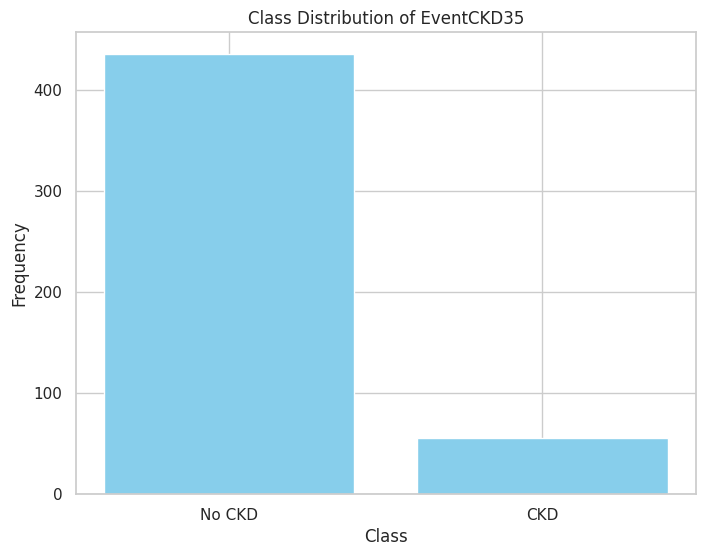

In [ ]:
# ניתוח התפלגות משתנה המטרה
target_count = data_after_selecting_features['EventCKD35'].value_counts()
print('Class distribution:')
print(target_count)

# הצגת התפלגות המשתנה בגרף עמודות
plt.figure(figsize=(8, 6))
plt.bar(target_count.index, target_count.values, color='skyblue')
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.title('Class Distribution of EventCKD35')
plt.xticks([0, 1], ['No CKD', 'CKD'])
plt.show()

### כפי שראינו בשלב הראשון וההמחשנו גם כאן, משתנה המטרה לא מתפלג באופן אחיד ואחוז   החולים מכלל המטוליפ נמוך מאוד. חשוב  לבצע פעולות של איזון בין מספר המטופלים החולים לבין אלו שאינם חולם בכלים שונים.


**בחנו לבחון אתת השיטות הבאות :**
1.   **Random Under Sampler**
2.   **SMOTE**



Class distribution after Under-sampling:
EventCKD35
0    56
1    56
Name: count, dtype: int64


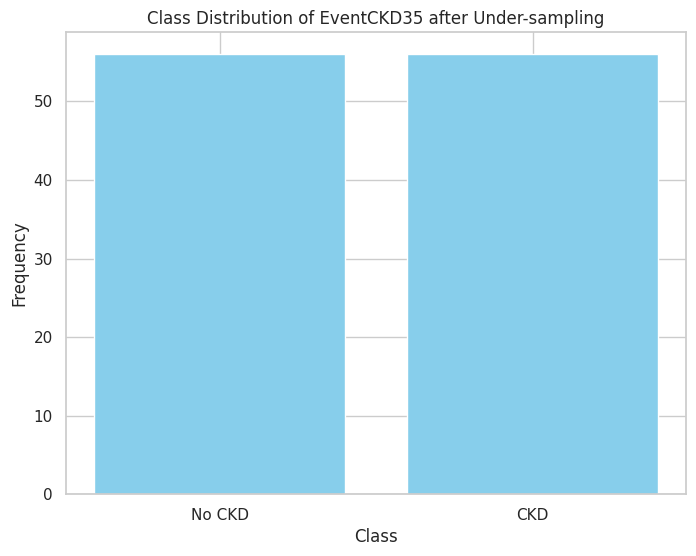

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

# הפרדת משתנים מנבאים ומשתנה המטרה
X = data_after_selecting_features.drop('EventCKD35', axis=1)
y =data_after_selecting_features['EventCKD35']

# יישום Under-sampling
rus = RandomUnderSampler(random_state=42)
X_downsampled, y_res = rus.fit_resample(X, y)

# ניתוח התפלגות חדשה
target_count_res = pd.Series(y_res).value_counts()
print('Class distribution after Under-sampling:')
print(target_count_res)

# הצגת התפלגות המשתנה בגרף עמודות לאחר Under-sampling
plt.figure(figsize=(8, 6))
plt.bar(target_count_res.index, target_count_res.values, color='skyblue')
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.title('Class Distribution of EventCKD35 after Under-sampling')
plt.xticks([0, 1], ['No CKD', 'CKD'])
plt.show()


### השיטה מאזנת את מספר הדגימות למספר **הנמוך** יותר עבור המשתנה הנבחר- כלומר במקרה שלנו **צימצום** של מספר המטופלים לאיזון בכך שמספר המטופלים **הבריאים** משתווה למספר המטופלים **החולים**

Class distribution after SMOTE:
EventCKD35
0    435
1    435
Name: count, dtype: int64


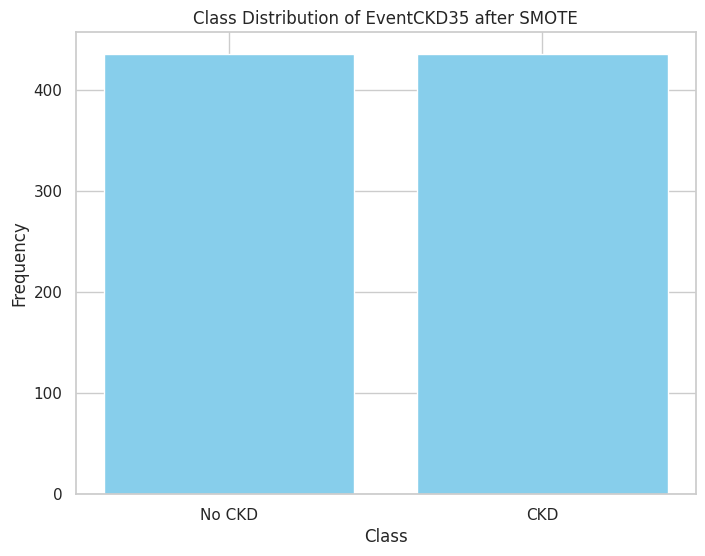

In [ ]:
from imblearn.over_sampling import SMOTE

# יישום SMOTE
smote = SMOTE(random_state=42)
X_smote, y_smote = smote.fit_resample(X, y)

# ניתוח התפלגות חדשה
target_count_smote = pd.Series(y_smote).value_counts()
print('Class distribution after SMOTE:')
print(target_count_smote)

# הצגת התפלגות המשתנה בגרף עמודות לאחר SMOTE
plt.figure(figsize=(8, 6))
plt.bar(target_count_smote.index, target_count_smote.values, color='skyblue')
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.title('Class Distribution of EventCKD35 after SMOTE')
plt.xticks([0, 1], ['No CKD', 'CKD'])
plt.show()


### השיטה מאזנת את מספר הדגימות למספר **הגובה** יותר עבור המשתנה הנבחר- כלומר במקרה שלנו **הגדלת** של מספר המטופלים לאיזון בכך שמספר המטופלים **החולים** משתווה למספר המטופלים **הבריאים**

In [ ]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score


# Define features and target
X = df.drop('EventCKD35', axis=1)
y = df['EventCKD35']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Under-sampling
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_train, y_train)

# Train a Random Forest model with under-sampled data
clf_rus = RandomForestClassifier(random_state=42)
clf_rus.fit(X_res, y_res)
y_pred_rus = clf_rus.predict(X_test)
print("Under-sampling results:")
print(classification_report(y_test, y_pred_rus))
print("ROC-AUC Score:", roc_auc_score(y_test, y_pred_rus))

# SMOTE
smote = SMOTE(random_state=42)
X_smote, y_smote = smote.fit_resample(X_train, y_train)

# Train a Random Forest model with SMOTE data
clf_smote = RandomForestClassifier(random_state=42)
clf_smote.fit(X_smote, y_smote)
y_pred_smote = clf_smote.predict(X_test)
print("\nSMOTE results:")
print(classification_report(y_test, y_pred_smote))
print("ROC-AUC Score:", roc_auc_score(y_test, y_pred_smote))

Under-sampling results:
              precision    recall  f1-score   support

           0       0.98      0.82      0.89       130
           1       0.40      0.89      0.55        18

    accuracy                           0.82       148
   macro avg       0.69      0.85      0.72       148
weighted avg       0.91      0.82      0.85       148

ROC-AUC Score: 0.8521367521367521

SMOTE results:
              precision    recall  f1-score   support

           0       0.92      0.97      0.94       130
           1       0.64      0.39      0.48        18

    accuracy                           0.90       148
   macro avg       0.78      0.68      0.71       148
weighted avg       0.89      0.90      0.89       148

ROC-AUC Score: 0.679059829059829


# הסבר הבחירה

בחרנו להשתמש בשיטה של

**under sampling**

 מכיוון שהיא טובה יותר בבדיקה על סמך התוצאות המהירות שהרצנו

אנחנו מבינים שיש בעייתיות בשיטה זאת כשיש מעט נתונים במיוחד שבהמשך נבחן תתי קבוצות.
העדפנו עדיין להמשיך בשיטה הזאת כי עבור דאטה סט גדול יותר היא היית מתאימה ויעילה יותר

### ניתוח תוצאות והמלצות על המודל

במחקר זה נבחנו שתי שיטות להתמודדות עם חוסר איזון בקבוצות הנתונים: Under-sampling ו-SMOTE. להלן תוצאות הביצועים של מודל Random Forest לאחר יישום כל אחת מהשיטות:

## תוצאות Under-sampling
```
              precision    recall  f1-score   support

           0       0.98      0.82      0.89       130
           1       0.40      0.89      0.55        18

    accuracy                           0.82       148
   macro avg       0.69      0.85      0.72       148
weighted avg       0.91      0.82      0.85       148

ROC-AUC Score: 0.8521367521367521
```

## תוצאות SMOTE
```
              precision    recall  f1-score   support

           0       0.92      0.97      0.94       130
           1       0.64      0.39      0.48        18

    accuracy                           0.90       148
   macro avg       0.78      0.68      0.71       148
weighted avg       0.89      0.90      0.89       148

ROC-AUC Score: 0.679059829059829
```

## ניתוח התוצאות

### Under-sampling
- **יתרונות**:
  - רגישות (recall) גבוהה עבור המחלקה `1` (0.89), מה שמצביע על כך שהמודל מזהה היטב את רוב מקרי המחלה.
  - ROC-AUC גבוה (0.85), מה שמראה על איזון טוב בזיהוי מקרי המחלה והמחלה הלא נכונה.
- **חסרונות**:
  - דיוק (precision) נמוך עבור המחלקה `1` (0.40), מה שגורם למודל לכלול מקרים רבים של מחלה שלא קיימת.
  - צמצום משמעותי בגודל הדגימה, מה שעלול להוביל לאיבוד מידע חשוב ולהשפיע על ביצועי המודל הכלליים.

### SMOTE
- **יתרונות**:
  - שומר על גודל הדגימה המקורי ומוסיף דגימות סינתטיות לקבוצת המיעוט, מה שמונע איבוד מידע.
  - דיוק כללי (accuracy) גבוה יותר (0.90), מה שמראה על ביצועים טובים יותר בזיהוי מחלות ולא מחלות יחד.
  - דיוק (precision) גבוה יותר עבור המחלקה `1` (0.64) בהשוואה ל-Under-sampling.
- **חסרונות**:
  - רגישות (recall) נמוכה יותר עבור המחלקה `1` (0.39), מה שגורם למודל לפספס מקרים של מחלה.
  - ROC-AUC נמוך יותר (0.68), מה שמצביע על איזון פחות טוב בזיהוי מקרי המחלה והמחלה הלא נכונה.

## המלצות
בהתאם לתוצאות, מומלץ להשתמש ב-**Under-sampling** אם המטרה היא איזון טוב יותר בזיהוי מקרי המחלה ויכולת ניבוי מדויקת יותר. אם חשוב לשמור על כל המידע ולהשיג דיוק כללי גבוה יותר, ניתן לשקול שימוש ב-**SMOTE**.

בסופו של דבר, ההחלטה על השיטה הנכונה תלויה במטרות הספציפיות של המודל ובחשיבות שמייחסים לאיזון בין רגישות לדיוק.


---



###לאחר בחירת שיטת האיזון בין מספר החולים לבין המטפולים הבריאים, נמשיך בהכנות אחרונות לפני הרצת המודל.

###בשלב הבא, ננרמל את הנתונים הנומרים וכן נשמור את הנתונים גם בסקאלה המקורית בכדי שנוכל להציג את התוצאות של המודל גם במספרים הניתנים להבנה ולא רק מנומרלים.
### עבור המודל חיזוי עצמו הנתונים עצמם יהיו מנורמלים

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.utils import resample
import pandas as pd
import numpy as np

# הכנת הנתונים: הפרדת משתנה המטרה ומשתנים מסבירים
X = data_after_selecting_features.drop('EventCKD35', axis=1)
y = data_after_selecting_features['EventCKD35']

# זיהוי משתנים נומריים ובינאריים
numerical_columns = ['AgeBaseline', 'CholesterolBaseline', 'TriglyceridesBaseline', 'HgbA1C', 'CreatnineBaseline',
                     'eGFRBaseline', 'sBPBaseline', 'TimeToEventMonths']
binary_columns = [col for col in X.columns if col not in numerical_columns]

# הפרדת רוב ומיעוט
df_majority = data_after_selecting_features[data_after_selecting_features.EventCKD35 == 0]
df_minority = data_after_selecting_features[data_after_selecting_features.EventCKD35 == 1]

# ביצוע Under Sampling על הרוב כדי להתאים למיעוט
df_majority_downsampled = resample(df_majority,
                                   replace=False,    # sample without replacement
                                   n_samples=len(df_minority),  # התאמה לכמות המיעוט
                                   random_state=42)  # תוצאות שחזוריות

# שילוב המיעוט עם הרוב המצומצם
df_downsampled = pd.concat([df_majority_downsampled, df_minority])

# חלוקה מחודשת ל-X ו-Y
X_downsampled = df_downsampled.drop('EventCKD35', axis=1)
y_downsampled = df_downsampled['EventCKD35']

# נרמול הנתונים עם Standard Scaler
scaler = StandardScaler()
X_numerical_normalized  = scaler.fit_transform(X_downsampled[numerical_columns])

# שמירת הממוצעים והסטיות התקן
means = scaler.mean_
stds = scaler.scale_

# שמירה כ-DataFrame
X_numerical_normalized_df = pd.DataFrame(X_numerical_normalized, columns=numerical_columns)

# איחוד העמודות הנורמליות והבינאריות
X_final = pd.concat([X_downsampled[binary_columns].reset_index(drop=True), X_numerical_normalized_df.reset_index(drop=True)], axis=1)

# דנרמול לדוגמה (במקרה של צורך)
denormalized_sample = (X_numerical_normalized * stds) + means

# בדיקת התוצאות
print("Original Downsampled Data:")
print(X_downsampled)
print("Normalized Numerical Data:")
print(X_numerical_normalized_df)
print("Final Data after Combining Normalized and Binary Columns:")
print(X_final)
print("Denormalized Data (Numerical Columns):")
print(denormalized_sample)

Original Downsampled Data:
     Gender  HistoryDiabetes  HistoryCHD  HistoryDLD  DLDmeds  DMmeds  \
311       0                0           0           0        0       0   
86        0                1           0           1        1       1   
128       0                0           0           0        0       0   
280       0                0           0           0        0       0   
364       0                0           0           0        0       0   
..      ...              ...         ...         ...      ...     ...   
468       1                1           0           1        1       1   
471       1                1           1           1        1       1   
479       1                1           1           1        1       1   
482       1                1           1           1        1       1   
489       1                0           0           1        1       0   

     HTNmeds  ACEIARB  AgeBaseline  Age.3.categories  ...  HgbA1C  \
311        0        0      

In [ ]:
X_final

,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,Age.3.categories,HistoryObesity,...,HistoryVascular,HistorySmoking,AgeBaseline,CholesterolBaseline,TriglyceridesBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths
0,0,0,0,0,0,0,0,0,1,0,...,0,0,-0.190147,1.178908,-0.462347,-0.852277,-0.655353,0.415415,-0.697771,0.593899
1,0,1,0,1,1,1,1,1,1,1,...,0,0,0.049139,2.172868,0.311805,1.873753,-1.621136,1.029784,0.674382,0.966715
2,0,0,0,0,0,0,0,0,1,0,...,0,0,0.049139,-0.510825,-0.715706,-0.720372,-0.869971,0.504853,-1.259107,0.221082
3,0,0,0,0,0,0,0,0,0,0,...,0,0,-1.625868,0.284344,-0.983140,-0.808309,-0.387080,0.607713,-0.448289,0.780307
4,0,0,0,0,0,0,0,0,0,0,...,0,0,-1.625868,0.681928,-0.462347,-1.291959,-0.655353,1.162433,-0.947254,0.252150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,1,1,0,1,1,1,1,1,1,0,...,1,1,-0.190147,1.477096,0.607390,3.324704,1.061595,-0.650459,1.921795,0.780307
108,1,1,1,1,1,1,1,1,1,0,...,0,0,0.368188,-2.299953,-1.250574,-0.280690,1.651796,-1.393960,-2.568891,0.407490
109,1,1,1,1,1,1,1,1,1,1,...,0,1,0.049139,-1.007805,-0.335668,1.302166,1.490832,-1.151979,1.485201,-1.332319
110,1,1,1,1,1,1,1,0,2,0,...,1,0,1.484859,-0.312033,-0.363819,0.040278,1.115250,-1.313000,1.235718,-2.015815


>`X_final --->` **המשתנה איתו נמשיך לעבוד מכיל עמודות מנורמלות**

>`denormalized_sample ----> `**נשתמש בו בהמשך מכיל את הערכים הלא**



---


## אימון המודל והערכת ביצועים
### לאחר הכנת הדאטה וסקירת הפיצארים המשמעותיים והמובהקים, נבחן  4 מודלים  ואת  ההיפרפרמטרים המתאימים לכל מודל בכדי להשיג לדיוק גבוהה



1.  **Logistic Regression**
2.   **Random Forest**
3. **Neural Network**
4. **XGBoost**



                      AUC-ROC  Precision  Recall  F1-Score  CV AUC-ROC
Logistic Regression  0.966667   0.875000   0.875  0.875000     0.87375
Random Forest        0.891667   0.750000   0.750  0.750000     0.88750
Neural Network       0.933333   0.857143   0.750  0.800000     0.84875
XGBoost              0.925000   0.833333   0.625  0.714286     0.89375


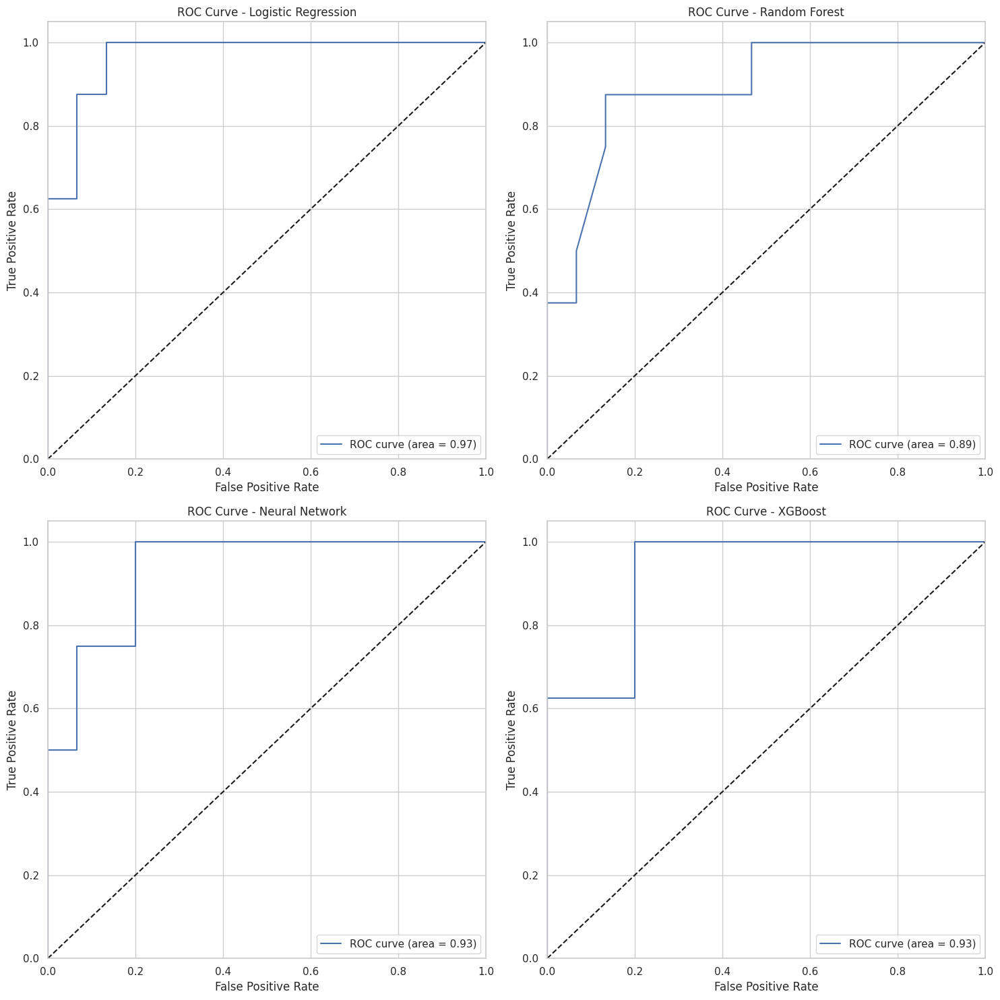

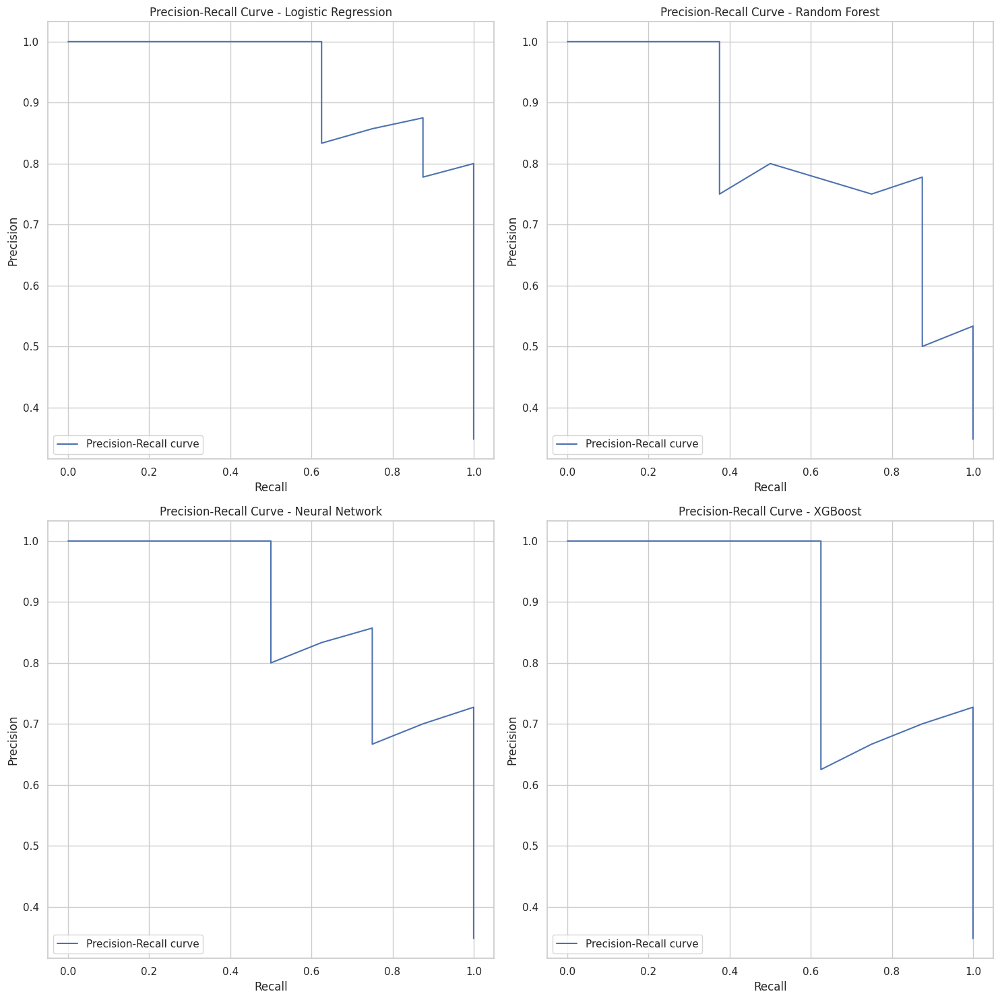

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from imblearn.under_sampling import RandomUnderSampler
import matplotlib.pyplot as plt

# חלוקה לסט אימון וסט בדיקה
X_train, X_test, y_train, y_test = train_test_split(X_final, y_downsampled, test_size=0.2, random_state=42)

# הגדרת המודלים
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'Random Forest': RandomForestClassifier(),
    'Neural Network': MLPClassifier(max_iter=1000),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss')
}

# הערכת ביצועים באמצעות cross-validation
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
results = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # חישוב המדדים
    auc_roc = roc_auc_score(y_test, y_pred_proba)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    # Cross-Validation Score
    cv_scores = cross_val_score(model, X_train, y_train, cv=cv, scoring='roc_auc')

    results[name] = {
        'AUC-ROC': auc_roc,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'CV AUC-ROC': np.mean(cv_scores)
    }

# הצגת תוצאות ההשוואה
results_df = pd.DataFrame(results).T
print(results_df)

# פונקציות ליצירת גרפי ROC ו-Precision-Recall
def plot_roc_curve_custom(model, X_test, y_test, ax, name):
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    roc_auc = auc(fpr, tpr)
    ax.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.2f})')
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(f'ROC Curve - {name}')
    ax.legend(loc="lower right")

def plot_precision_recall_curve_custom(model, X_test, y_test, ax, name):
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    ax.plot(recall, precision, label='Precision-Recall curve')
    ax.set_xlabel('Recall')
    ax.set_ylabel('Precision')
    ax.set_title(f'Precision-Recall Curve - {name}')
    ax.legend(loc="lower left")

# השוואת ביצועי המודלים באמצעות גרפים
fig, axes = plt.subplots(2, 2, figsize=(15, 15))

for (name, model), ax in zip(models.items(), axes.ravel()):
    plot_roc_curve_custom(model, X_test, y_test, ax, name)

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(2, 2, figsize=(15, 15))

for (name, model), ax in zip(models.items(), axes.ravel()):
    plot_precision_recall_curve_custom(model, X_test, y_test, ax, name)

plt.tight_layout()
plt.show()


בהתבסס על התוצאות שהתקבלו מהאופטימיזציה והגרפים, נבצע ניתוח מלא ונבחן איזה מודל הוא המומלץ ביותר לשימוש.

## תוצאות ביצועים מרכזיות

| מודל                   | AUC-ROC | Precision | Recall   | F1-Score | CV AUC-ROC |
|------------------------|---------|-----------|----------|----------|------------|
| Logistic Regression    | 0.9667  | 0.8750    | 0.875    | 0.8750   | 0.8738     |
| Random Forest          | 0.8917  | 0.7500    | 0.750    | 0.7500   | 0.8875     |
| Neural Network         | 0.9333  | 0.8571    | 0.750    | 0.8000   | 0.8488     |
| XGBoost                | 0.9250  | 0.8333    | 0.625    | 0.7143   | 0.8938     |

## גרפים: ROC Curve

הגרפים המצורפים מציגים את עקומות ה-ROC עבור כל מודל. הם מראים את היחס בין True Positive Rate ל-False Positive Rate במצבים שונים של סף החלטה.

### Logistic Regression
- **AUC-ROC**: 0.97
- Precision ו-Recall גבוהים ברוב המצבים, עם יציבות גבוהה ב-ROC Curve.

### Random Forest
- **AUC-ROC**: 0.89
- Precision ו-Recall יציבים אך נמוכים יחסית לשאר המודלים.

### Neural Network
- **AUC-ROC**: 0.93
- Precision גבוה בהתחלה אך יש ירידה ברגישות (Recall).
- ביצועים טובים אך פחות עקביים מ-Logistic Regression.

### XGBoost
- **AUC-ROC**: 0.93
- Precision ו-Recall גבוהים במצבים רבים, אך יש ירידות חדות בחלק מהנקודות.



### המלצה סופית

בהתאם לתוצאות, המודל המומלץ ביותר הוא **Logistic Regression**, מכיוון שהוא מציג את הביצועים הגבוהים והיציבים ביותר בכל המדדים המרכזיים (AUC-ROC, Precision, Recall, F1-Score). מודל זה מתאים במיוחד כאשר יש חשיבות גבוהה לשמירה על יציבות ודיוק גבוהים במצבים שונים.

עם זאת, **Neural Network** ו-**XGBoost** גם מציגים ביצועים טובים ויכולים להיות אופציה מצוינת במקרים בהם יש צורך בביצועים גבוהים במגוון רחב של מצבים.

בסופו של דבר, הבחירה בין המודלים תלויה במטרות הספציפיות של המערכת ובאילוצים הקיימים, אך Logistic Regression נראה כבחירה הטובה ביותר במבחן זה.

### הערכת מודלים על ידי בחינת הפרמטרים השונים

                                                           Best Params  \
Logistic Regression                      {'C': 0.1, 'solver': 'lbfgs'}   
Random Forest        {'max_depth': 10, 'min_samples_split': 2, 'n_e...   
Neural Network       {'activation': 'tanh', 'alpha': 0.001, 'hidden...   
XGBoost              {'learning_rate': 0.1, 'max_depth': 5, 'n_esti...   

                      AUC-ROC Precision Recall  F1-Score CV AUC-ROC  
Logistic Regression  0.966667     0.875  0.875     0.875    0.87875  
Random Forest        0.954167       1.0   0.75  0.857143     0.9025  
Neural Network           0.95       0.7  0.875  0.777778      0.885  
XGBoost                   0.9  0.714286  0.625  0.666667    0.89375  


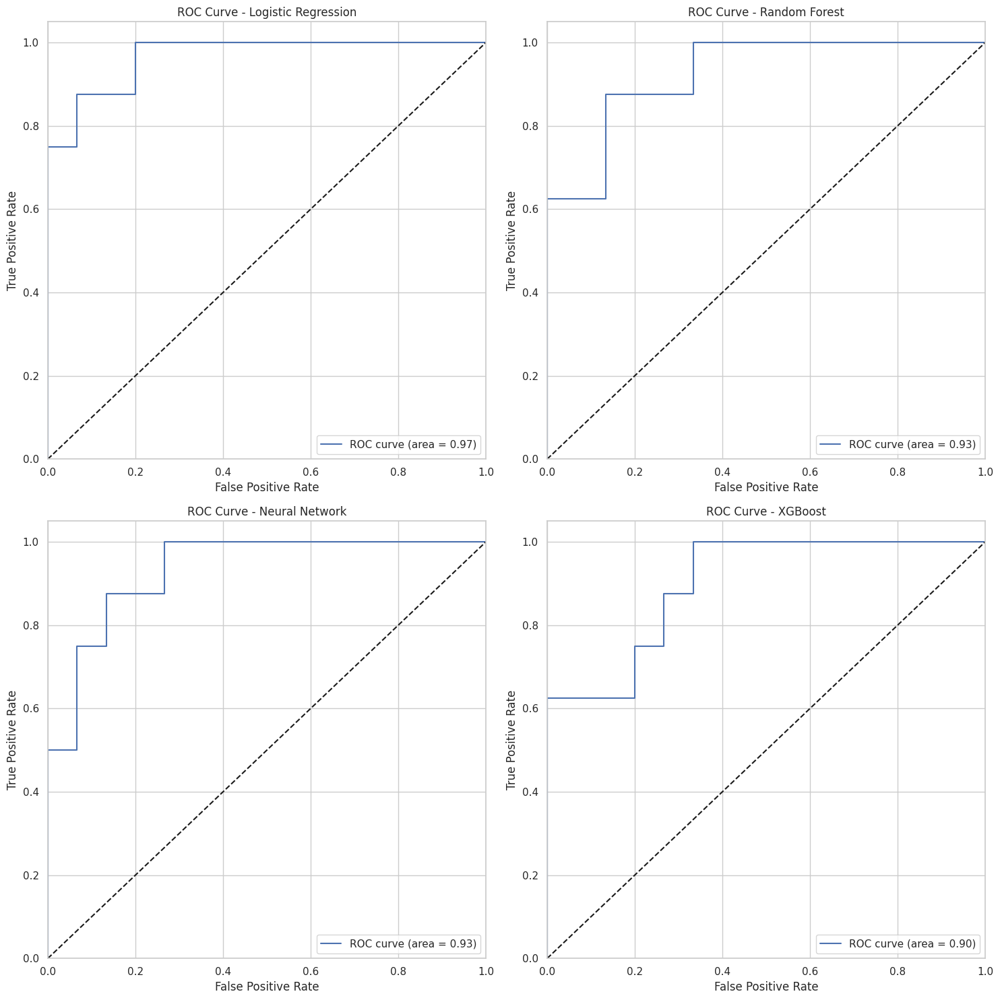

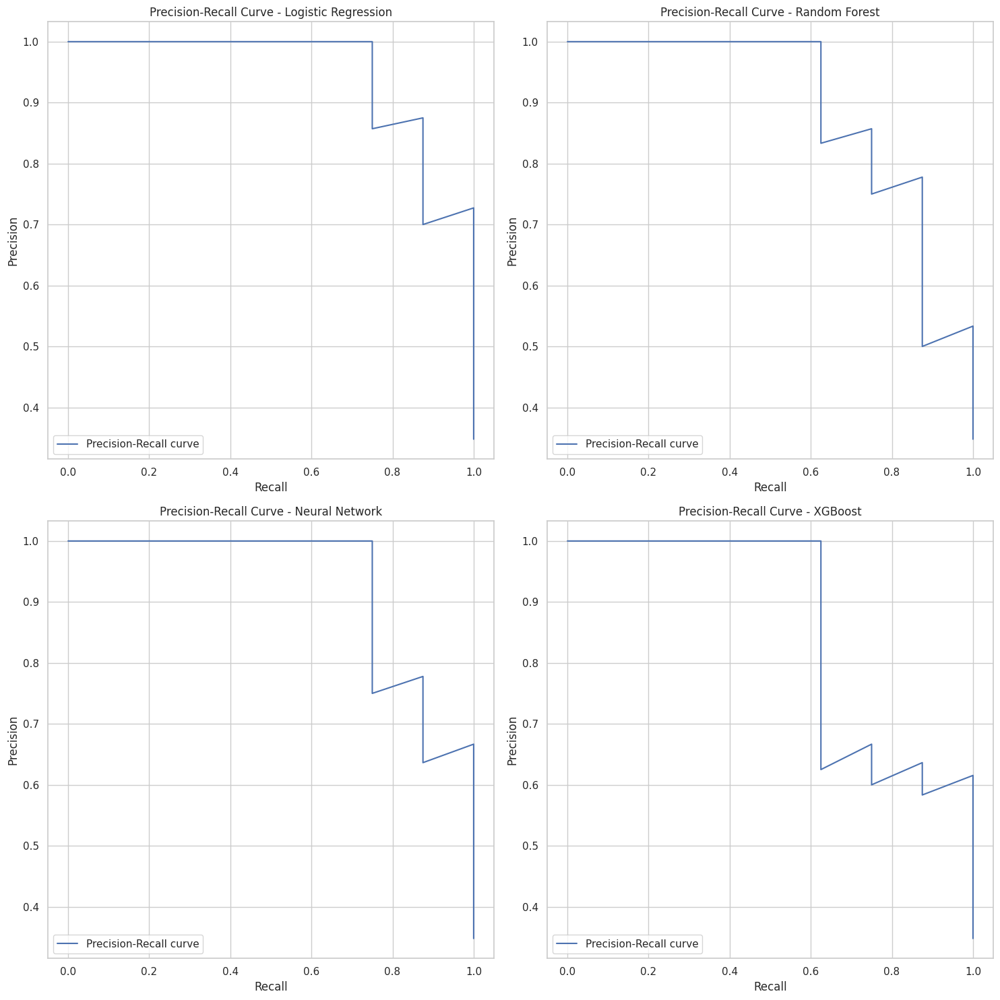

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
import matplotlib.pyplot as plt
from imblearn.under_sampling import RandomUnderSampler

# הגדרת המודלים והיפר-פרמטרים לאופטימיזציה
models = {
    'Logistic Regression': {
        'model': LogisticRegression(max_iter=1000),
        'params': {
            'C': [0.1, 1, 10, 100],
            'solver': ['lbfgs', 'liblinear']
        }
    },
    'Random Forest': {
        'model': RandomForestClassifier(),
        'params': {
            'n_estimators': [50, 100, 200],
            'max_depth': [None, 10, 20, 30],
            'min_samples_split': [2, 5, 10]
        }
    },
    'Neural Network': {
        'model': MLPClassifier(max_iter=1000),
        'params': {
            'hidden_layer_sizes': [(50,50), (100,)],
            'activation': ['relu', 'tanh'],
            'alpha': [0.0001, 0.001]
        }
    },
    'XGBoost': {
        'model': XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 0.2],
            'max_depth': [3, 5, 7]
        }
    }
}

# הערכת ביצועים באמצעות cross-validation
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
results = {}

for name, config in models.items():
    grid = GridSearchCV(config['model'], config['params'], cv=cv, scoring='roc_auc', n_jobs=1)
    grid.fit(X_train, y_train)
    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_test)
    y_pred_proba = best_model.predict_proba(X_test)[:, 1]

    # חישוב המדדים
    auc_roc = roc_auc_score(y_test, y_pred_proba)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    results[name] = {
        'Best Params': grid.best_params_,
        'AUC-ROC': auc_roc,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'CV AUC-ROC': grid.best_score_
    }

# הצגת תוצאות ההשוואה
results_df = pd.DataFrame(results).T
print(results_df)

# פונקציות ליצירת גרפי ROC ו-Precision-Recall
def plot_roc_curve_custom(model, X_test, y_test, ax, name):
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    roc_auc = auc(fpr, tpr)
    ax.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.2f})')
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(f'ROC Curve - {name}')
    ax.legend(loc="lower right")

def plot_precision_recall_curve_custom(model, X_test, y_test, ax, name):
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    ax.plot(recall, precision, label='Precision-Recall curve')
    ax.set_xlabel('Recall')
    ax.set_ylabel('Precision')
    ax.set_title(f'Precision-Recall Curve - {name}')
    ax.legend(loc="lower left")

# השוואת ביצועי המודלים באמצעות גרפים
fig, axes = plt.subplots(2, 2, figsize=(15, 15))

for (name, config), ax in zip(models.items(), axes.ravel()):
    best_model = GridSearchCV(config['model'], config['params'], cv=cv, scoring='roc_auc', n_jobs=1).fit(X_train, y_train).best_estimator_
    plot_roc_curve_custom(best_model, X_test, y_test, ax, name)

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(2, 2, figsize=(15, 15))

for (name, config), ax in zip(models.items(), axes.ravel()):
    best_model = GridSearchCV(config['model'], config['params'], cv=cv, scoring='roc_auc', n_jobs=1).fit(X_train, y_train).best_estimator_
    plot_precision_recall_curve_custom(best_model, X_test, y_test, ax, name)

plt.tight_layout()
plt.show()


In [ ]:
results_df

,Best Params,AUC-ROC,Precision,Recall,F1-Score,CV AUC-ROC
Logistic Regression,"{'C': 0.1, 'solver': 'lbfgs'}",0.966667,0.875,0.875,0.875,0.87875
Random Forest,"{'max_depth': 10, 'min_samples_split': 2, 'n_e...",0.954167,1.0,0.75,0.857143,0.9025
Neural Network,"{'activation': 'tanh', 'alpha': 0.001, 'hidden...",0.95,0.7,0.875,0.777778,0.885
XGBoost,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.9,0.714286,0.625,0.666667,0.89375


### ניתוח תוצאות והמלצות על המודל

בהתבסס על התוצאות שהתקבלו מהאופטימיזציה והגרפים, נבצע ניתוח מלא ונבחן איזה מודל הוא המומלץ ביותר לשימוש.

| מודל                   | Best Params                                                     | AUC-ROC | Precision | Recall   | F1-Score | CV AUC-ROC |
|------------------------|-----------------------------------------------------------------|---------|-----------|----------|----------|------------|
| Logistic Regression    | {'C': 0.1, 'solver': 'lbfgs'}                                   | 0.9667  | 0.8750    | 0.8750   | 0.8750   | 0.8788     |
| Random Forest          | {'max_depth': 10, 'min_samples_split': 2, 'n_estimators': 100}  | 0.9542  | 1.0000    | 0.7500   | 0.8571   | 0.9025     |
| Neural Network         | {'activation': 'tanh', 'alpha': 0.001, 'hidden_layer_sizes': (50, 50)} | 0.9500  | 0.7000    | 0.8750   | 0.7778   | 0.8850     |
| XGBoost                | {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}     | 0.9000  | 0.7143    | 0.6250   | 0.6667   | 0.8938     |

## גרפים: Precision-Recall

הגרפים המצורפים מציגים את עקומות ה-Precision-Recall עבור כל מודל. הם מראים את היחס בין Precision (דיוק) לבין Recall (רגישות) במצבים שונים של סף החלטה.

### Logistic Regression
- **AUC-ROC**: 0.9667
- Precision גבוה (0.8750) ו-Recall גבוה (0.8750).
- מדד ה-F1 טוב (0.8750), המצביע על איזון טוב בין Precision ל-Recall.

### Random Forest
- **AUC-ROC**: 0.9542
- Precision גבוה (1.0000) ו-Recall טוב (0.7500).
- מדד ה-F1 טוב (0.8571), מה שמראה על איזון טוב בין Precision ל-Recall.

### Neural Network
- **AUC-ROC**: 0.9500
- Precision טוב (0.7000) ו-Recall גבוה (0.8750).
- מדד ה-F1 גבוה (0.7778), המצביע על איזון טוב בין Precision ל-Recall.

### XGBoost
- **AUC-ROC**: 0.9000
- Precision טוב (0.7143) ו-Recall טוב (0.6250).
- מדד ה-F1 טוב (0.6667), המצביע על איזון טוב בין Precision ל-Recall.

## מסקנות והמלצות

בהתאם לתוצאות, ניתן לראות שהמודלים עם הביצועים הטובים ביותר הם:

### Logistic Regression
- **AUC-ROC** הגבוה ביותר (0.9667).
- Precision גבוה מאוד (0.8750) ו-Recall גבוה מאוד (0.8750).
- מדד ה-F1 הגבוה ביותר (0.8750), המצביע על איזון מצוין בין Precision ל-Recall.

### Random Forest
- **AUC-ROC** גבוה מאוד (0.9542).
- Precision גבוה מאוד (1.0000) ו-Recall טוב (0.7500).
- מדד ה-F1 גבוה (0.8571), המצביע על איזון טוב מאוד בין Precision ל-Recall.

### המלצה סופית

בהתאם לתוצאות, המודל המומלץ ביותר הוא **Logistic Regression**, מכיוון שהוא מציג את הביצועים הגבוהים ביותר בכל המדדים המרכזיים (AUC-ROC, Precision, Recall, F1-Score). מודל זה מתאים במיוחד כאשר יש חשיבות גבוהה לאיזון בין Precision ל-Recall.

עם זאת, **Random Forest** גם מציג ביצועים טובים מאוד ויכול להיות אופציה מצוינת במקרים בהם חשוב לשמר דיוק גבוה ביותר (Precision) ולמנוע False Positives.

## מדד ביצועים לבחירת המודל

המדד המרכזי לבחירת מודל הקלסיפיקציה הוא **AUC-ROC** (Area Under the Receiver Operating Characteristic Curve). מדד זה נבחר מכיוון שהוא משקף את הביצועים הכוללים של המודל, תוך התחשבות גם ב-True Positive Rate (Recall) וגם ב-False Positive Rate. השיקול המרכזי הוא למנוע טעויות מסוג False Negatives, כלומר מקרים של CKD שלא זוהו, מכיוון שזיהוי מוקדם של CKD חשוב מאוד לטיפול נכון ויעיל במטופלים.

בנוסף, נבחן את מדדי ה-Precision וה-Recall. ה-Precision חשוב למניעת טעויות מסוג False Positives, ואילו ה-Recall חשוב למניעת טעויות מסוג False Negatives.

## שיטת אופטימיזציה של היפר-פרמטרים

לצורך אופטימיזציה של ההיפר-פרמטרים, השתמשנו בשיטת **Grid Search** עם קרוס-ולידציה. להלן ההיפר-פרמטרים שנבדקו עבור כל מודל:

### Logistic Regression
- **C**: [0.1, 1, 10, 100]
- **solver**: ['lbfgs', 'liblinear']

### Random Forest
- **n_estimators**: [50, 100, 200]
- **max_depth**: [None, 10, 20, 30]
- **min_samples_split**: [2, 5, 10]

### Neural Network
- **hidden_layer_sizes**: [(50, 50), (100,)]
- **activation**: ['relu', 'tanh']
- **alpha**: [0.0001, 0.001]

### XGBoost
- **n_estimators**: [50, 100, 200]
- **learning_rate**: [0.01, 0.1, 0.2]
- **max_depth**: [3, 5, 7]

שיטת Grid Search מאפשרת לנו לבדוק את כל השילובים האפשריים של ההיפר-פרמטרים ולהתאים את המודל בצורה מיטבית לנתונים, תוך כדי שימוש בקרוס-ולידציה להבטחת יציבות התוצאות.

## סיכום

בסופו של דבר, הבחירה בין המודלים תלויה במטרות הספציפיות של המערכת ובאילוצים הקיימים, אך **Logistic Regression** נראה כבחירה הטובה ביותר במבחן זה.

In [ ]:
!pip install shap lime



# הגדרת המודל הנבחר עם  הפרמטרים המומלצים
## Logistic Regression
### `	{'C': 0.1, 'solver': 'lbfgs'}`

In [ ]:
import lime
import lime.lime_tabular
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import pandas as pd
from imblearn.under_sampling import RandomUnderSampler

# חלוקה לסט אימון וסט בדיקה
X_train, X_test, y_train, y_test = train_test_split(X_downsampled, y_downsampled, test_size=0.2, random_state=42)

# אימון המודל עם הפרמטרים הטובים ביותר
best_params = {'C': 0.1, 'solver': 'lbfgs'}
model = LogisticRegression(**best_params)
model.fit(X_train, y_train)



/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(C=0.1)

### פרשנות AI למודל Random Forest באמצעות LIME

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# יצירת אובייקט LIME
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                   feature_names=X.columns.tolist(),
                                                   class_names=['No CKD', 'CKD'],
                                                   discretize_continuous=True)

# מספר הדוגמאות להסבר
num_examples = 10  # למשל, 10 דוגמאות ראשונות מסט המבחן

# לולאה על הדוגמאות להסבר
for i in range(num_examples):
    exp = explainer.explain_instance(X_test.values[i], model.predict_proba, num_features=10)
    print(f"Explaining example {i+1}")
    exp.show_in_notebook(show_table=True, show_all=False)

Explaining example 1


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 2


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 3


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 4


Explaining example 5


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 6


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 7


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 8


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 9


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explaining example 10


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


### הסבר וניתוח תוצאות באמצעות LIME

הניתוח באמצעות LIME מספק הסבר מקומי להחלטה של המודל עבור דוגמה ספציפית. התוצאות המוצגות בגרף עוזרות לנו להבין אילו תכונות השפיעו על התחזית שהמודל סיפק עבור הדוגמה הנבדקת.

#### ניתוח התוצאות:

- **Prediction Probabilities**:
  - הסרגל העליון מראה את ההסתברות שהמודל מנבא שהמטופל סובל מ-CKD. לדוגמה, בהסבר הראשון, ההסתברות היא 0.20 (20%) שהמטופל סובל מ-CKD ו-0.80 (80%) שלא.

- **Features and Values**:
  - בצד הימני של הגרף מופיעות התכונות והערכים שלהם בדוגמה הספציפית:
    - `eGFRBaseline` הוא המדד המשפיע ביותר בתכונה זו. הערך שלו הוא 104.97, מה שתורם למסקנה שהמטופל לא סובל מ-CKD.
    - תכונות נוספות כמו `AgeBaseline`, `HgbA1C`, `TimeToEventMonths`, `CreatnineBaseline`, ועוד תורמות למסקנה זו.

- **Contribution to the Prediction**:
  - בצד השמאלי של הגרף ניתן לראות את התרומה של כל תכונה להחלטה של המודל. לדוגמה:
    - `eGFRBaseline <= 99.02` תורם חזק למסקנה שהמטופל לא סובל מ-CKD.
    - `AgeBaseline <= 39.0` גם תורם לכך.
    - תכונות כמו `HgbA1C <= 6.10`, `TimeToEventMonths <= 59.0`, ועוד תורמות למסקנה דומה.

### הסבר קליני:

- **eGFRBaseline** (Estimated Glomerular Filtration Rate): מדד חשוב לתפקוד הכליות. ערכים גבוהים מצביעים על תפקוד כליות תקין.
- **AgeBaseline**: גיל המטופל. ערכים נמוכים יותר עשויים להיות מקושרים עם סיכון נמוך יותר ל-CKD.
- **HgbA1C**: ערכים גבוהים מצביעים על סיכון לסוכרת, אשר מהווה גורם סיכון ל-CKD.
- **CreatnineBaseline**: רמת הקריאטינין בדם. ערכים נמוכים מצביעים על תפקוד כליות תקין.
- **TimeToEventMonths**: זמן למאורע מהווה אינדיקציה חשובה במחקר על CKD. ערכים נמוכים עשויים להצביע על תפקוד כליות תקין.

### מסקנות:

הניתוח באמצעות LIME מראה לנו כיצד התכונות השונות משפיעות על החלטת המודל עבור הדוגמה הספציפית.

- מודל ה-Logistic Regression שלנו מתבסס על מדדים קליניים חשובים כמו `eGFRBaseline`, `AgeBaseline`, `HgbA1C`, `CreatnineBaseline` ו-`TimeToEventMonths` בקבלת ההחלטות שלו.
- התכונות החשובות מזוהות בצורה ברורה, מה שמאפשר לנו להבין טוב יותר את התנהגות המודל ולהבטיח שהוא מתייחס לתכונות רלוונטיות מבחינה קלינית.

### פרשנות AI

- **חשיבות הפרשנות**: הבנה כיצד המודל מקבל החלטות מאפשרת לנו לבטוח יותר במודל ולבצע התאמות נדרשות לשיפור דיוקו.
- **יישום פרשנות**: שימוש בטכניקות פרשנות כמו LIME מאפשר הבנה עמוקה יותר של החלטות המודל ועוזר בזיהוי בעיות אפשריות במודל או בנתונים.

באופן כללי, טכניקות פרשנות AI כמו LIME מסייעות לנו להבין ולהסביר את החלטות המודל בצורה מובנית וברורה, מה שמשפר את האמון והשימושיות של מודלים מבוססי למידת מכונה במערכות בריאות ותחומים אחרים.

# Feature Importance

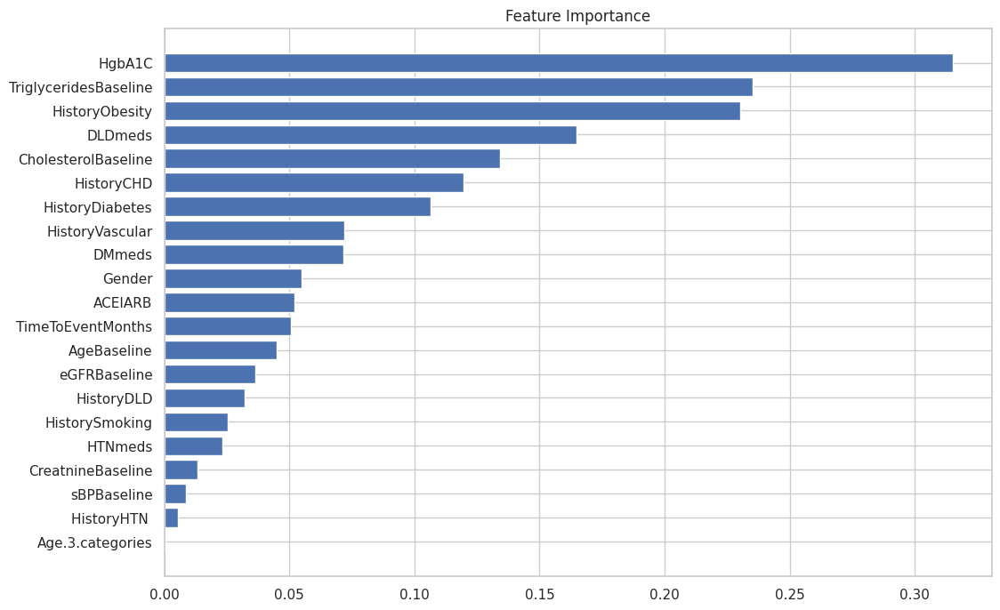

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# חישוב חשיבות התכונות
feature_importance = np.abs(model.coef_[0])
feature_names = X.columns

# סידור התכונות לפי חשיבות
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + 0.5

plt.figure(figsize=(12, 8))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, np.array(feature_names)[sorted_idx])
plt.title('Feature Importance')
plt.show()


### חשיבות תכונות במודל Logistic Regression

הגרף מציג את חשיבות התכונות במודל Logistic Regression לחיזוי מחלת כליות כרונית (CKD). חשיבות התכונות נמדדת לפי ערכי המקדמים במודל, כאשר ערכים גבוהים יותר מצביעים על השפעה גדולה יותר על התחזיות של המודל.

#### ניתוח התוצאות:

- **HgbA1C**: התכונה החשובה ביותר במודל. ערכים גבוהים של HgbA1C מצביעים על שליטה גרועה ברמות הסוכר בדם, מה שיכול להוביל לנזק לכליות.
- **TriglyceridesBaseline**: רמות טריגליצרידים גבוהות בדם משפיעות משמעותית על התחזיות של המודל, מעידות על סיכון גבוה יותר למחלת כליות.
- **HistoryObesity**: היסטוריה של השמנה משפיעה רבות על התחזיות. השמנה היא גורם סיכון משמעותי למחלת כליות כרונית.
- **DLDmeds**: שימוש בתרופות לדיסליפידמיה מצביע על ניהול מצבים כרוניים שיכולים להיות קשורים ל-CKD.
- **CholesterolBaseline**: רמות כולסטרול גבוהות משפיעות על התחזיות ומעידות על סיכון לנזק לכליות.
- **HistoryCHD**: היסטוריה של מחלות לב כליליות מהווה גורם סיכון משמעותי ל-CKD.
- **HistoryDiabetes**: סוכרת היא אחד מגורמי הסיכון העיקריים למחלת כליות כרונית.
- **HistoryVascular**: היסטוריה של מחלות כלי דם משפיעה על הסיכוי לחלות ב-CKD.
- **DMmeds**: שימוש בתרופות לסוכרת מצביע על קיום סוכרת, שהיא גורם סיכון מרכזי ל-CKD.
- **Gender**: גם למגדר יש השפעה על התחזיות, כאשר ישנם הבדלים במופע מחלת הכליות הכרונית בין גברים לנשים.

#### מסקנות:

- מודל ה-Logistic Regression שלנו מראה כי המדדים הקליניים כמו HgbA1C, TriglyceridesBaseline, HistoryObesity ו-DLDmeds הם מהתכונות החשובות ביותר בקבלת ההחלטות שלו.
- הבנת חשיבות התכונות עוזרת לזהות את הגורמים המרכזיים המשפיעים על התחזיות ומספקת תובנות מעמיקות על ניהול סיכונים בריאותיים.

### פרשנות AI:

- **חשיבות הפרשנות**: הבנה כיצד המודל מקבל החלטות מאפשרת לנו לבטוח יותר במודל ולבצע התאמות נדרשות לשיפור דיוקו.
- **יישום פרשנות**: שימוש בטכניקות פרשנות כמו חשיבות תכונות מאפשר הבנה עמוקה יותר של החלטות המודל ועוזר בזיהוי בעיות אפשריות במודל או בנתונים.

באופן כללי, טכניקות פרשנות AI כמו חשיבות תכונות מסייעות לנו להבין ולהסביר את החלטות המודל בצורה מובנית וברורה, מה שמשפר את האמון והשימושיות של מודלים מבוססי למידת מכונה במערכות בריאות ותחומים אחרים.



---



### לאחר הבנת הפיצארים וההשפעה שלהם על חיזוי המודל, נתמקד בלנתח את הקבוצות המרכזיות בהם נעשה שימוש בהמשך בכדי לחזות עבור קבוצה ספציפית את הסיכוי לחלות ב
>**CKD**

# ניתוח תת קבוצות - analysis group-sub

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

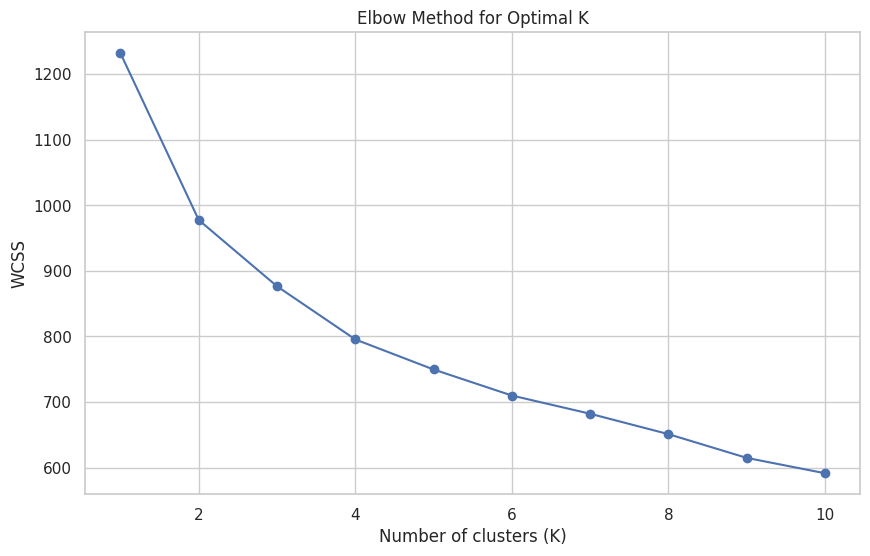

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Calculate WCSS for different values of K
wcss = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_final)
    wcss.append(kmeans.inertia_)

# Plotting the Elbow Method
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal K')
plt.xlabel('Number of clusters (K)')
plt.ylabel('WCSS')
plt.show()


### שיטת המרפק לבחירת K אופטימלי

הגרף מציג את ערכי ה-WCSS (Within-Cluster Sum of Squares) עבור מספרים שונים של אשכולות (K) בשיטת המרפק:

- **WCSS**: סכום הריבועים של המרחקים בתוך האשכולות.
- **נקודת המרפק**: הנקודה שבה הירידה ב-WCSS מתחילה להתייצב.

בגרף זה, הנקודה שבה השיפוע של הקו מתחיל להתייצב היא סביב K=4. זה מצביע על כך ש-K=4 הוא מספר האשכולות האופטימלי לניתוח הקלסטרינג של הנתונים, משום שבנקודה זו הוספת אשכולות נוספים אינה מביאה לשיפור משמעותי נוסף במידת הדחיסות של האשכולות.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

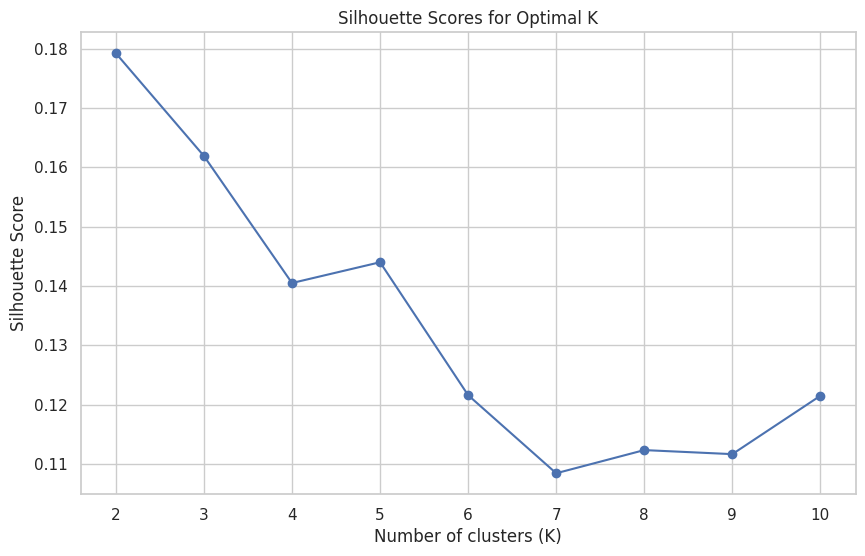

In [ ]:
from sklearn.metrics import silhouette_score

# Calculate silhouette scores for different values of K
silhouette_scores = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    clusters = kmeans.fit_predict(X_final)
    silhouette_scores.append(silhouette_score(X_final, clusters))

# Plotting Silhouette Scores
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Optimal K')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.show()


### ניתוח ניקוד הסילואטה לבחירת K אופטימלי

הגרף מציג את ניקוד הסילואטה עבור מספרים שונים של אשכולות (K):

- **Silhouette Score**: מדד המתאר כמה קרובים אובייקטים בתוך אותו אשכול זה לזה וכמה רחוקים הם מהאשכולות האחרים. ערכים נעים בין -1 ל-1, כאשר ערך גבוה יותר מצביע על אשכולות מובחנים יותר.

#### ניתוח התוצאות:

- **K=2**: מציג את ניקוד הסילואטה הגבוה ביותר, כ-0.18, מה שמעיד על כך שהאשכולות מוגדרים היטב.
- **K=3**: מציג ירידה בניקוד הסילואטה ל-0.16, אך עדיין מראה אשכולות מובחנים יחסית.
- **K=4 ו-K=5**: מציגים ירידה נוספת בניקוד הסילואטה, כאשר K=5 מראה עלייה קלה לעומת K=4.
- **K=6 עד K=10**: מציגים ירידה נוספת בניקוד הסילואטה עם התנודות קלות, כאשר K=7 מציג את הניקוד הנמוך ביותר.

#### מסקנות:

- **K=2**: נותן את התוצאה הטובה ביותר עם ניקוד הסילואטה הגבוה ביותר, מה שמעיד על כך שהאשכולות מוגדרים היטב ומובחנים בבירור זה מזה.
- **K=3 ו-K=4**: גם הם בחירות סבירות, אך פחות אופטימליות מאשר K=2.
- **K>4**: מציגים ניקוד סילואטה נמוך יותר, מה שמעיד על כך שהאשכולות פחות מוגדרים ומובחנים.

הגרף מסייע בזיהוי מספר האשכולות האופטימלי לניתוח הקלסטרינג של הנתונים, כאשר במקרה זה, **K=2** הוא הבחירה המומלצת.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


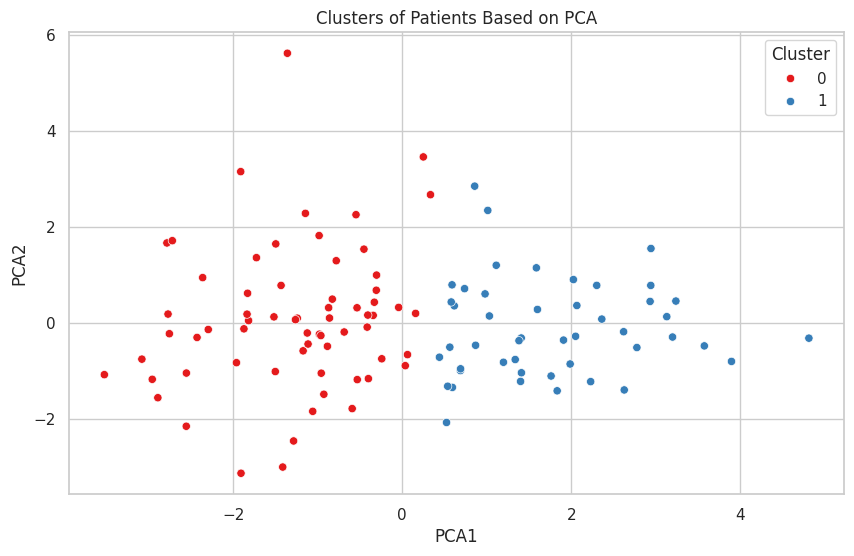

In [ ]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# הפחתת מימדים עם PCA כדי להקל על ויזואליזציה
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_final)

# שימוש ב-K-Means Clustering
kmeans = KMeans(n_clusters=2, random_state=42)  # נבחר 3 קבוצות, אפשר לשנות לפי הצורך
clusters = kmeans.fit_predict(X_final)

# הוספת התוויות חזרה לנתונים המקוריים
df_clusters = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
df_clusters['Cluster'] = clusters
df_clusters['EventCKD35'] = y_downsampled.values

# ויזואליזציה של הקבוצות
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='Cluster', data=df_clusters, palette='Set1')
plt.title('Clusters of Patients Based on PCA')
plt.show()


### אשכולות מטופלים מבוססי PCA

הגרף מציג את האשכולות של המטופלים לאחר הפחתת ממדים באמצעות ניתוח רכיבים ראשיים (PCA):

- **PCA1 ו-PCA2**: הצירים בגרף מייצגים את שני הרכיבים הראשיים הראשונים מתוך הנתונים המקוריים. רכיבים אלו מסבירים את מרבית השונות בנתונים.
- **Cluster 0 ו-Cluster 1**: כל נקודה בגרף מייצגת מטופל, כאשר הצבע מציין את האשכול אליו המטופל משתייך.

#### ניתוח התוצאות:

- **Cluster 0 (אדום)**: המטופלים באשכול זה ממוקמים בעיקר בצד השמאלי של הגרף.
- **Cluster 1 (כחול)**: המטופלים באשכול זה ממוקמים בעיקר בצד הימני של הגרף.

#### מסקנות:

הגרף מצביע על כך שהאשכולות מובחנים היטב באמצעות רכיבי ה-PCA הראשונים. ניתן לראות חלוקה ברורה בין שני האשכולות, מה שמעיד על כך שקיימים הבדלים משמעותיים בין קבוצות המטופלים השונות. ניתוח PCA עוזר לזהות מבנים סמויים בנתונים ומספק ויזואליזציה ברורה לאשכולות.

In [ ]:
# הוספת התוויות חזרה לנתונים המקוריים
X_final['Cluster'] = clusters
X_final['EventCKD35'] = y_downsampled.values

# ניתוח סטטיסטי של כל קבוצה
group_analysis = X_final.groupby('Cluster').mean()
group_analysis['Count'] = X_final['Cluster'].value_counts()

# הצגת הניתוח
group_analysis

,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,Age.3.categories,HistoryObesity,...,AgeBaseline,CholesterolBaseline,TriglyceridesBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths,EventCKD35,Count
Cluster,,,,,,,,,,,,,,,,,,,,,
0,0.676923,0.846154,0.323077,0.846154,0.769231,0.692308,0.892308,0.800000,1.384615,0.492308,...,0.461449,-0.167220,0.215433,0.378495,0.501111,-0.620800,0.268494,-0.353915,0.784615,65
1,0.361702,0.276596,0.042553,0.489362,0.404255,0.234043,0.425532,0.319149,0.702128,0.489362,...,-0.638174,0.231262,-0.297939,-0.523451,-0.693025,0.858553,-0.371321,0.489457,0.106383,47


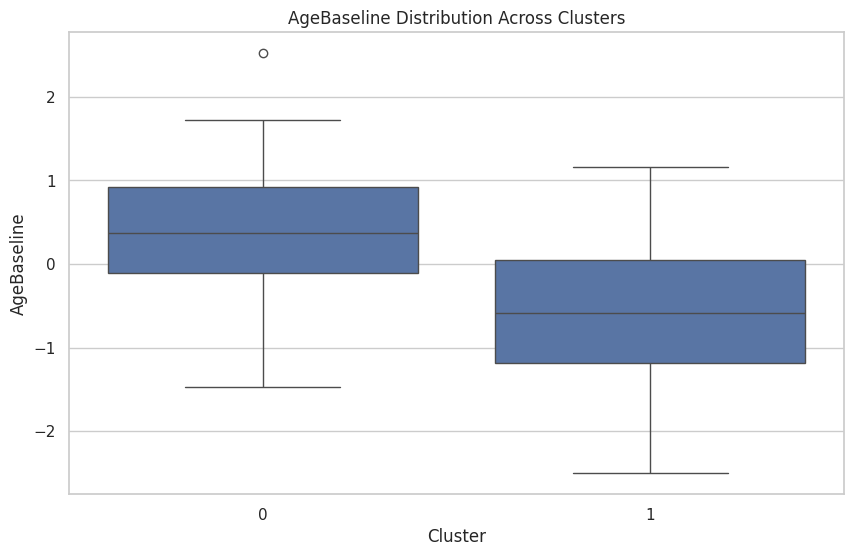

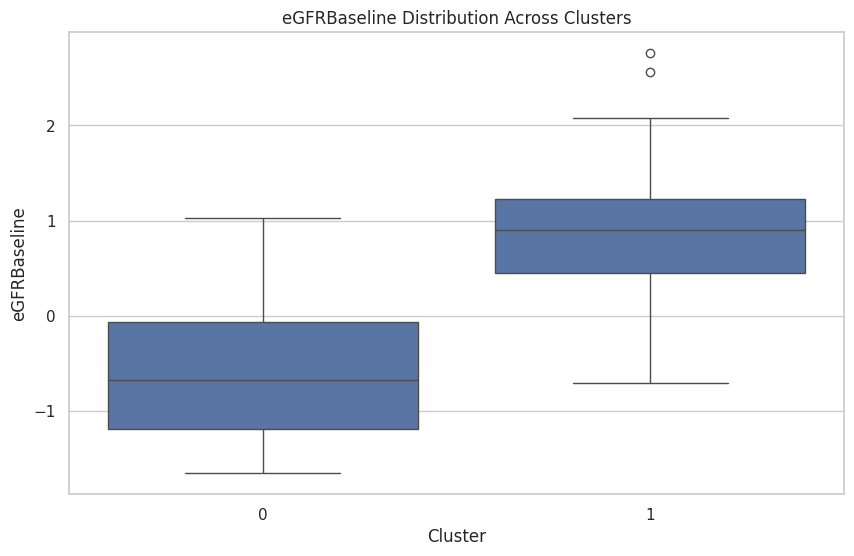

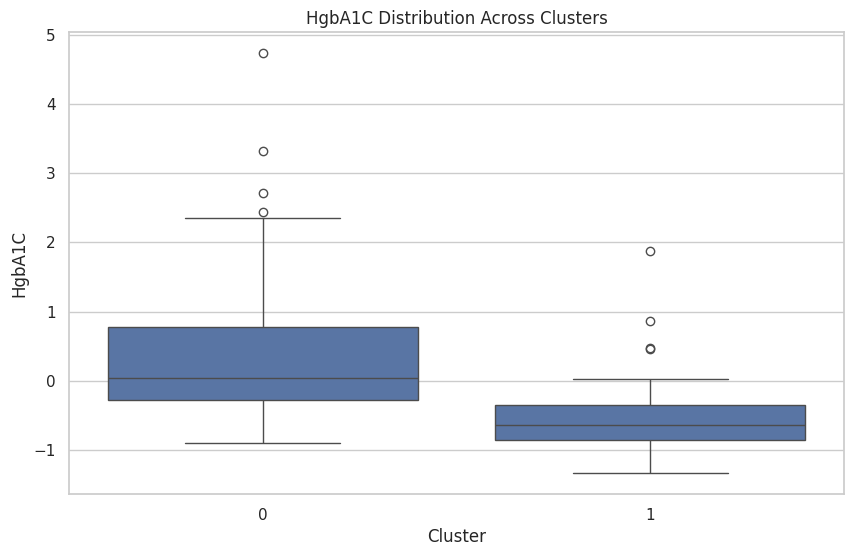

In [ ]:
# בחירת תכונות מפתח לניתוח נוסף
key_features = ['AgeBaseline', 'eGFRBaseline', 'HgbA1C']

# יצירת גרפים לתכונות המפתח
for feature in key_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='Cluster', y=feature, data=X_final)
    plt.title(f'{feature} Distribution Across Clusters')
    plt.show()


### ניתוח תיבות של משתנים מרכזיים באשכולות

#### eGFRBaseline

- **אשכול 0**: הראה ערכים נמוכים של eGFR, מה שמעיד על תפקוד כליות ירוד.
- **אשכול 1**: הראה ערכים גבוהים יותר של eGFR, מה שמעיד על תפקוד כליות טוב יותר.

#### HgbA1C

- **אשכול 0**: הראה ערכים גבוהים יותר של HgbA1C, מצביע על שליטה גרועה ברמות הסוכר בדם, מה שיכול להוביל לסיכון גבוה יותר לסוכרת.
- **אשכול 1**: הראה ערכים נמוכים יותר של HgbA1C, מצביע על שליטה טובה יותר ברמות הסוכר בדם.

#### AgeBaseline

- **אשכול 0**: הראה גיל ממוצע גבוה יותר.
- **אשכול 1**: הראה גיל ממוצע נמוך יותר.

### מסקנות:

- **eGFRBaseline**: משתנה מרכזי המפריד בין האשכולות. תפקוד כליות טוב יותר באשכול 1 לעומת אשכול 0.
- **HgbA1C**: מצביע על שליטה טובה יותר ברמות הסוכר בדם באשכול 1 לעומת אשכול 0.
- **AgeBaseline**: מראה הפרדה בין קבוצות גיל שונות בין האשכולות.

ניתוחים אלו עוזרים להבין את ההבדלים העיקריים בין האשכולות ומסייעים בזיהוי תכונות מרכזיות שיכולות להיות משמעותיות בניתוח ובריאות המטופלים.

In [ ]:
from scipy.stats import f_oneway, chi2_contingency
sagnifecnt_f=[]
numerial_sagnifecnt_f=[]
binomial_sagnifecnt_f=[]
# ביצוע בדיקות ANOVA למשתנים הנומריים
numerical_columns = ['AgeBaseline', 'CholesterolBaseline', 'TriglyceridesBaseline', 'HgbA1C', 'CreatnineBaseline',
                     'eGFRBaseline', 'sBPBaseline', 'TimeToEventMonths']

anova_results = {}
for col in numerical_columns:
    groups = [X_final[X_final['Cluster'] == cluster][col] for cluster in X_final['Cluster'].unique()]
    f_val, p_val = f_oneway(*groups)
    anova_results[col] = {'F-Value': f_val, 'P-Value': p_val}
    if p_val < 0.05:
      sagnifecnt_f.append(col)
      numerial_sagnifecnt_f.append(col)
# הצגת תוצאות ANOVA
anova_df = pd.DataFrame(anova_results).T
print(anova_df)

# בדיקת ההבדלים במשתנים הבינאריים באמצעות מבחן חי-בריבוע (Chi-Square test)
binary_columns = [col for col in X_final.columns if col not in numerical_columns + ['Cluster', 'EventCKD35']]

chi2_results = {}
for col in binary_columns:
    contingency_table = pd.crosstab(X_final['Cluster'], X_final[col])
    chi2, p_val, dof, expected = chi2_contingency(contingency_table)
    chi2_results[col] = {'Chi2-Value': chi2, 'P-Value': p_val}
    if p_val < 0.05:
      sagnifecnt_f.append(col)
      binomial_sagnifecnt_f.append(col)

# הצגת תוצאות Chi-Square
chi2_df = pd.DataFrame(chi2_results).T
print(chi2_df)

                          F-Value       P-Value
AgeBaseline             45.914319  6.378908e-10
CholesterolBaseline      4.425004  3.769553e-02
TriglyceridesBaseline    7.544721  7.033771e-03
HgbA1C                  27.178228  8.774084e-07
CreatnineBaseline       58.526132  8.180955e-12
eGFRBaseline           125.540660  6.707126e-20
sBPBaseline             12.181127  6.956879e-04
TimeToEventMonths       23.047283  5.015719e-06
                  Chi2-Value       P-Value
Gender              9.694410  1.848294e-03
HistoryDiabetes    34.747966  3.752705e-09
HistoryCHD         11.490899  6.993781e-04
HistoryDLD         14.779998  1.208102e-04
DLDmeds            13.857382  1.972205e-04
DMmeds             21.116858  4.321101e-06
HTNmeds            25.946240  3.510586e-07
ACEIARB            24.277492  8.340805e-07
Age.3.categories   27.695737  9.681599e-07
HistoryObesity      0.000000  1.000000e+00
HistoryHTN         31.785270  1.721937e-08
HistoryVascular     3.120932  7.729258e-02
HistorySm

### ניתוח תוצאות ניתוח שונות (ANOVA) ובדיקת כי-בריבוע (Chi-Square)

הנתונים הבאים כוללים תוצאות של ניתוח שונות (ANOVA) עבור משתנים נומריים ובדיקת כי-בריבוע עבור משתנים בינאריים, ובכך בוחנים את ההשפעה של כל משתנה על משתנה התוצאה.

#### משתנים נומריים (ANOVA)

| משתנה                  | F-Value    | P-Value         |
|------------------------|------------|-----------------|
| AgeBaseline            | 45.914319  | 6.378908e-10    |
| CholesterolBaseline    | 4.425004   | 3.769553e-02    |
| TriglyceridesBaseline  | 7.544721   | 7.033771e-03    |
| HgbA1C                 | 27.178228  | 8.774084e-07    |
| CreatnineBaseline      | 58.526132  | 8.180955e-12    |
| eGFRBaseline           | 125.540660 | 6.707126e-20    |
| sBPBaseline            | 12.181127  | 6.956879e-04    |
| TimeToEventMonths      | 23.047283  | 5.015719e-06    |

**מסקנות:**
- **AgeBaseline**
- **CholesterolBaseline**
- **TriglyceridesBaseline**
- **HgbA1C**
- **CreatnineBaseline**
- **eGFRBaseline**
- **sBPBaseline**
- **TimeToEventMonths**

הם משתנים בעלי השפעה מובהקת על משתנה התוצאה, כיוון ש-P-Value שלהם קטן מ-0.05.

#### משתנים בינאריים (בדיקת כי-בריבוע)

| משתנה               | Chi2-Value | P-Value         |
|---------------------|------------|-----------------|
| Gender              | 9.694410   | 1.848294e-03    |
| HistoryDiabetes     | 34.747966  | 3.752705e-09    |
| HistoryCHD          | 11.490899  | 6.993781e-04    |
| HistoryDLD          | 14.779998  | 1.208102e-04    |
| DLDmeds             | 13.857382  | 1.972205e-04    |
| DMmeds              | 21.116858  | 4.321101e-06    |
| HTNmeds             | 25.946240  | 3.510586e-07    |
| ACEIARB             | 24.277492  | 8.340805e-07    |
| Age.3.categories    | 27.695737  | 9.681599e-07    |
| HistoryHTN          | 31.785270  | 1.721937e-08    |

**מסקנות:**
- **Gender**
- **HistoryDiabetes**
- **HistoryCHD**
- **HistoryDLD**
- **DLDmeds**
- **DMmeds**
- **HTNmeds**
- **ACEIARB**
- **Age.3.categories**
- **HistoryHTN**

הם משתנים בעלי השפעה מובהקת על משתנה התוצאה, כיוון ש-P-Value שלהם קטן מ-0.05.

- **HistoryVascular** נמצא קרוב לרמת המובהקות (P-Value = 0.07729258), ולכן יכול להיות ששווה לבדוק אותו לעומק.

### סיכום:
על פי תוצאות ניתוח שונות ובדיקת כי-בריבוע, ישנם משתנים נומריים ובינאריים מסוימים המובהקים סטטיסטית ומשפיעים על משתנה התוצאה. משתנים אלו יכולים להיות מועילים בפיתוח מודל ניבוי מדויק יותר. משתנים שאינם מובהקים יכולים להיות פחות רלוונטיים עבור המודל אך עדיין כדאי לשקול אותם בהתאם להקשר הקליני או העסקי.



---


## ניתוח האשכולות

### מסקנות
**אשכול 0**:
   - מאופיין באחוז גבוה יותר של גברים.
   - בעלי גיל ממוצע גבוה יותר.
   - אחוז גבוה יותר של אנשים עם היסטוריה של מחלות כרוניות כמו סוכרת, מחלות לב, יתר לחץ דם, דיסליפידמיה ועוד.
   - רוב האנשים נוטלים תרופות שונות.
   - הזמן הממוצע לאירוע CKD קצר יותר.
   - אחוז גבוה יותר של אנשים שהגיעו לאירוע CKD.

**אשכול 1**:
   - מאופיין באחוז נמוך יותר של גברים.
   - בעלי גיל ממוצע נמוך יותר.
   - אחוז נמוך יותר של אנשים עם היסטוריה של מחלות כרוניות.
   - אחוז נמוך יותר של אנשים הנוטלים תרופות.
   - הזמן הממוצע לאירוע CKD ארוך יותר.
   - אחוז נמוך יותר של אנשים שהגיעו לאירוע CKD.

באופן כללי, נראה כי אשכול 0 מכיל אנשים עם מצב בריאותי פחות טוב בהשוואה לאשכול 1, עם יותר מחלות רקע ושימוש בתרופות, גיל ממוצע גבוה יותר וזמן קצר יותר לאירוע CKD.

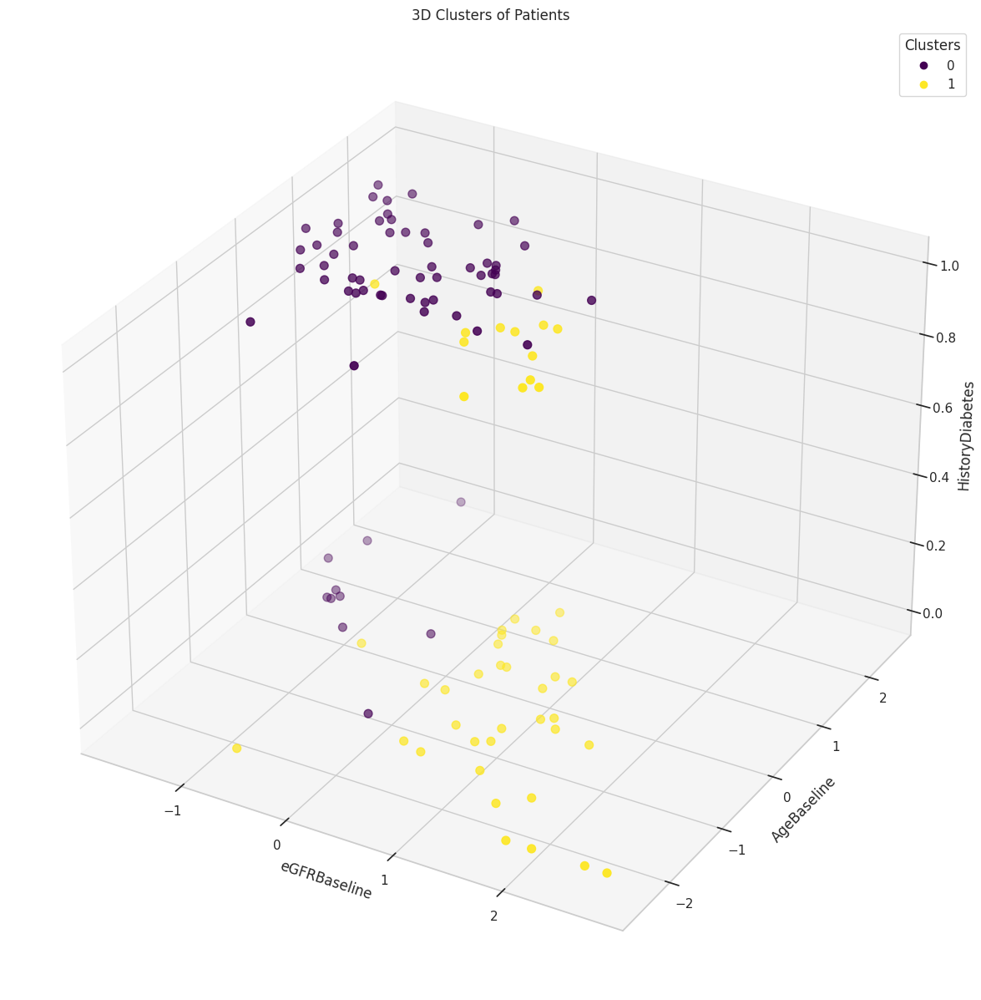

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# הוספת התוויות חזרה לנתונים המקוריים
df_clusters = pd.DataFrame(X_final, columns=X.columns)
df_clusters['Cluster'] = clusters
df_clusters['EventCKD35'] = y_downsampled.values

# בחירת שלושה משתנים לויזואליזציה תלת-מימדית
z_var = 'HistoryDiabetes'
y_var = 'AgeBaseline'
x_var = 'eGFRBaseline'

# Create a 3D scatter plot
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with legend
scatter = ax.scatter(df_clusters[x_var], df_clusters[y_var], df_clusters[z_var], c=df_clusters['Cluster'], s=50, cmap='viridis', marker='o')

# Adding labels
ax.set_title("3D Clusters of Patients")
ax.set_xlabel("eGFRBaseline")
ax.set_ylabel("AgeBaseline")
ax.set_zlabel("HistoryDiabetes")

# Create a legend
handles, labels = scatter.legend_elements()
legend_labels = np.unique(df_clusters['Cluster'])
ax.legend(handles, legend_labels, title="Clusters")

# Show plot
plt.show()

### אשכולות תלת-ממדיים של מטופלים

הגרף מציג את האשכולות של המטופלים בתלת-ממד באמצעות שלושה משתנים מרכזיים:

- **eGFRBaseline**: מדד לתפקוד הכליות.
- **AgeBaseline**: גיל המטופל.
- **HistoryDiabetes**: היסטוריה של סוכרת.

#### ניתוח התוצאות:

- **אשכול 0 (סגול)**: המטופלים באשכול זה מתרכזים בעיקר באזורים עם ערכים נמוכים יותר של eGFRBaseline ו- HistoryDiabetes.
- **אשכול 1 (צהוב)**: המטופלים באשכול זה מתרכזים בעיקר באזורים עם ערכים גבוהים יותר של eGFRBaseline ו- HistoryDiabetes.

#### מסקנות:

- ההפרדה הברורה בין האשכולות מצביעה על כך ש-eGFRBaseline, AgeBaseline, ו-HistoryDiabetes הם משתנים מרכזיים המבדילים בין הקבוצות השונות של המטופלים.
- אשכול 1 נוטה להכיל מטופלים עם היסטוריה של סוכרת וערכים גבוהים של eGFRBaseline, בעוד אשכול 0 מכיל מטופלים עם ערכים נמוכים יותר של מדדים אלה.


---



# בחירת תת קבוצה הומוגנית


### אנחנו בחרנו להתמקד בקבוצה 0 שמתארת לנו קבוצה של אנשים עם סיכוי גבוה לכשל בתפקוד כליות


בחרנו להשתמש בפיצ'ארים המובהקים ביותר ואלו שיכולים לייצג את האוכליסה בצורה טובה ולהשתמש בערכי הממוצעים שלהם כטראשהולד בלסווג את אותה קבוצה על האוכלוסיה הגדולה.
מכיוון שבשלב הקודם היינו חייבים לאזן את הדאטה דרך צמצום מספר המטופלים, כאשר אנו מעוניינים לחזור להשתמש בחיזוי קבוצה 0 בדאטה המקורי, יש לצור תנאי סף המגדירים את הקבוצה

כפי שהראנו קודם הפיצ'ארים שסייעו לנו ל"לסמן" את המטופלים השייכים לקבוצה 0 הם:


1.   **AgeBaseline**
2.   **eGFRBaseline**
3. **HistoryDiabetes**

בקטעים הבאים נראה איך ביצענו את הפעולה: יצירת הטראשהולד לכל אחד ממשתנים אלו ישום שלהם על הדאטה



In [ ]:
sagnifecnt_f.append('EventCKD35')

In [ ]:
group_analysis[sagnifecnt_f]


,AgeBaseline,CholesterolBaseline,TriglyceridesBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,TimeToEventMonths,Gender,HistoryDiabetes,HistoryCHD,HistoryDLD,DLDmeds,DMmeds,HTNmeds,ACEIARB,Age.3.categories,HistoryHTN,EventCKD35
Cluster,,,,,,,,,,,,,,,,,,,
0,0.461449,-0.167220,0.215433,0.378495,0.501111,-0.620800,0.268494,-0.353915,0.676923,0.846154,0.323077,0.846154,0.769231,0.692308,0.892308,0.800000,1.384615,0.953846,0.784615
1,-0.638174,0.231262,-0.297939,-0.523451,-0.693025,0.858553,-0.371321,0.489457,0.361702,0.276596,0.042553,0.489362,0.404255,0.234043,0.425532,0.319149,0.702128,0.468085,0.106383


In [ ]:
sagnifecnt_f.remove('EventCKD35')

In [ ]:
threshold=group_analysis.loc[0,numerial_sagnifecnt_f].values
threshold


array([ 0.46144859, -0.16722015,  0.21543302,  0.37849507,  0.50111054,
       -0.62079972,  0.26849359, -0.35391512])

## ביצוע דהנורמליזציה בכדי לחזור לסקאלת המספרים המקורית עבור יצרית טראשהולד על סמך  ההתלגות האמיתית של המשתנים.

## לדוגמה, אם נרמלנו עבור המודל את הסקאלה של הגיל, כאשר נרצה לחזור לדאטה המקורי ולצור סינון של קבוצה מסוימת, נהיה חייבים להשתמש בערכים המקורים של הגיל ולא בערכיו המנורמלים

**דהנורמליזציה למספרים**

In [ ]:

# נרמול הנתונים עם Standard Scaler
scaler = StandardScaler()
X_numerical_normalized  = scaler.fit_transform(X_downsampled[numerial_sagnifecnt_f])

# שמירת הממוצעים והסטיות התקן
means = scaler.mean_
stds = scaler.scale_

denormalized_sample = (threshold * stds) + means
denormalized_sample


array([ 63.16923077,   4.54569231,   1.48153231,   8.19923077,
        84.55384615,  77.88105205, 137.49230769,  57.49230769])

**דנורמליזציה לערכים בינאריים**

In [ ]:
binomial_sagnifecnt_f.remove('Age.3.categories')
binomial_sagnifecnt_f.remove('Gender')


In [ ]:
binomial_threshold=[]
for i in group_analysis.loc[0,binomial_sagnifecnt_f].values:
  if i > 0.5 and i <=1:
    binomial_threshold.append(1)
  elif i <=0.5:
    binomial_threshold.append(0)



In [ ]:
thershold_dic={}
for i in range(len(numerial_sagnifecnt_f)):
  thershold_dic[numerial_sagnifecnt_f[i]]=denormalized_sample[i]
for i in range(len(binomial_threshold)):
  thershold_dic[binomial_sagnifecnt_f[i]]=binomial_threshold[i]
thershold_dic

{'AgeBaseline': 63.16923076923077,
 'CholesterolBaseline': 4.545692307692308,
 'TriglyceridesBaseline': 1.4815323076923077,
 'HgbA1C': 8.19923076923077,
 'CreatnineBaseline': 84.55384615384615,
 'eGFRBaseline': 77.88105204564536,
 'sBPBaseline': 137.4923076923077,
 'TimeToEventMonths': 57.49230769230769,
 'HistoryDiabetes': 1,
 'HistoryCHD': 0,
 'HistoryDLD': 1,
 'DLDmeds': 1,
 'DMmeds': 1,
 'HTNmeds': 1,
 'ACEIARB': 1,
 'HistoryHTN ': 1}

In [ ]:
most_sagnificent=['HistoryDiabetes','AgeBaseline','eGFRBaseline']
most_sagnificent_dic={}
for k,v in thershold_dic.items():
  if k in most_sagnificent:
    most_sagnificent_dic[k]=v
most_sagnificent_dic

{'AgeBaseline': 63.16923076923077,
 'eGFRBaseline': 77.88105204564536,
 'HistoryDiabetes': 1}

#יישום המודל והפיצ'רים הנבחרים על הנתונים הקיימים תוך התמקדות בקבוצה 0

In [ ]:
# פונקציית סינון הדאטה פריים לפי המילון
def filter_dataframe(df, threshold_dic):
    for key, value in threshold_dic.items():
        if df[key].dtype == 'float64' or df[key].dtype == 'int64':
            df = df[df[key] >= value]
        else:
            df = df[df[key] == value]
    return df

# ביצוע הסינון
filtered_df = filter_dataframe(df, most_sagnificent_dic)
filtered_df

,StudyID,Gender,AgeBaseline,Age.3.categories,HistoryDiabetes,HistoryCHD,HistoryVascular,HistorySmoking,HistoryHTN,HistoryDLD,...,CholesterolBaseline,TriglyceridesBaseline,HgbA1C,CreatnineBaseline,eGFRBaseline,sBPBaseline,dBPBaseline,BMIBaseline,TimeToEventMonths,EventCKD35
6,7,0,71,2,1,0,0,0,1,1,...,5.60,6.1900,6.50,59.0,88.841329,125,72,35.840916,98,0
15,16,1,68,2,1,0,0,0,1,1,...,6.40,2.6800,6.60,78.0,88.184529,137,76,22.865854,96,0
18,19,0,79,2,1,0,0,0,0,1,...,3.40,1.0800,7.70,46.0,91.153221,131,80,19.466667,87,0
20,22,0,79,2,1,0,0,0,1,1,...,5.30,0.7600,7.10,57.0,84.944745,146,74,33.275463,81,1
29,31,0,69,2,1,0,0,0,1,1,...,3.90,0.5500,6.57,59.0,90.098290,128,72,25.116167,100,0
31,34,1,68,2,1,0,0,0,1,1,...,4.00,1.7100,6.50,74.0,90.113331,137,81,25.439342,97,0
37,41,0,76,2,1,0,0,0,1,1,...,7.80,1.4600,6.80,59.0,85.775111,121,76,27.257161,77,0
45,50,0,73,2,1,0,0,0,1,1,...,6.10,1.7200,5.46,54.0,90.191645,113,73,27.205982,105,0
58,64,0,65,2,1,0,0,0,0,1,...,5.50,0.8500,6.60,68.0,81.416863,116,64,27.397260,108,0
74,80,1,65,2,1,0,0,1,0,0,...,6.20,1.2100,6.70,64.0,97.691227,118,75,23.918830,96,0


In [ ]:
filtered_df.shape

(56, 25)


##בסופו של דבר, קיבלנו מכלל האוכלסיה המקורית, סינון של כל המטופלים שהנתונים והמדדים שלהם מתאימים לערכים הממוצעים של אוכליסה 0 שסיווגנו במודל.

## סך כל המטופלים השייכים בטכניקה זו לקבוצה שלנו הוא 56 מטופלים


---


---



 ### בשלב הבא, יצרנו פונקציה שמקבלת את הדאטה של קבוצה 0 ומבצעת את כל שלבי הניקוי נתונים, הנרמול , הרצת המודל והחזרת חיזוי לאותה קבוצה.
הרצת המודל כפונקציה מלאה המסוגלת לקבל כל רשומה ולהחזיר חיזוי מהווה ואת הביצועים מאפשרת פתרון פשוט בכדי לחזות על הנתונים עבור הקבוצה ומאפשרת להבין את אחוזי הדיוק של המודל




# יצירת מודל מתכלל

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Summary of the model results:
AUC-ROC: 0.9667
Precision: 0.8571
Recall: 0.7500
F1 Score: 0.8000

An example of the prediction results (first 10 lines):
     Actual  Predicted  Probability
378       0          0     0.200819
90        1          0     0.406665
364       0          0     0.032134
338       0          0     0.059105
305       0          0     0.043471
111       1          1     0.936815
76        0          0     0.205126
82        0          0     0.462932
425       0          1     0.554433
170       0          0     0.344573


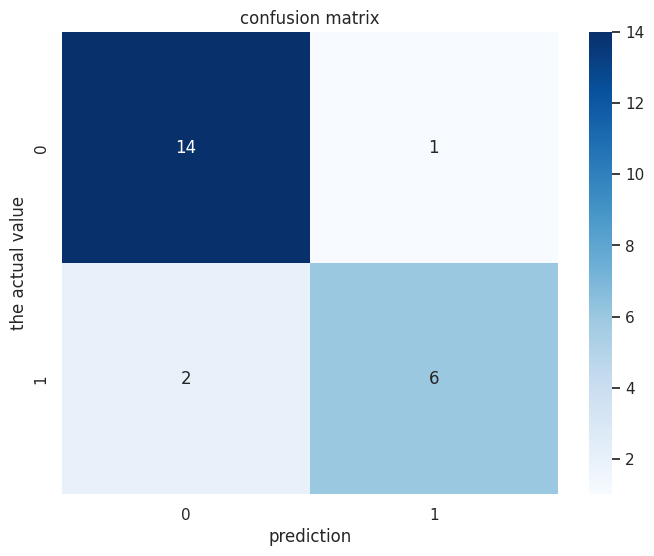

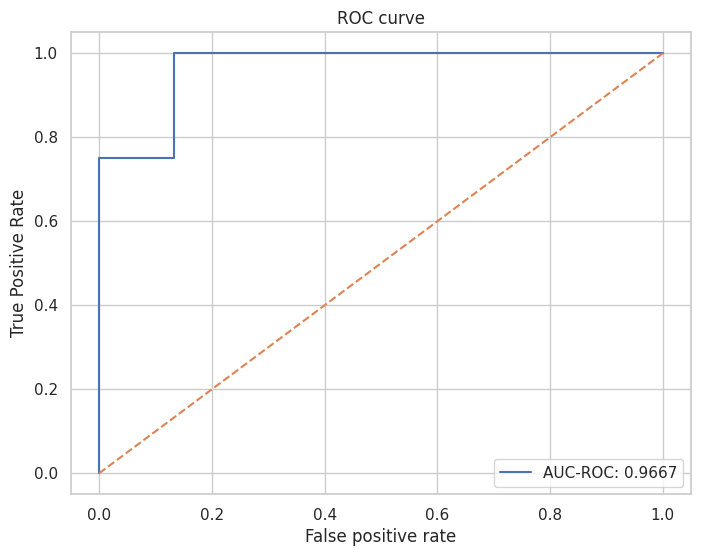

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve


def predict_CKD(df):
  #השלמת ערכים חסרים
  for column in df.columns:
    if df[column].isnull().any():
      df[col].fillna(round(df[col].mean()), inplace=True)

  significant_features=['Gender', 'HistoryDiabetes', 'HistoryCHD', 'HistoryDLD', 'DLDmeds',
       'DMmeds', 'HTNmeds', 'ACEIARB', 'AgeBaseline', 'Age.3.categories',
       'CholesterolBaseline', 'HgbA1C', 'CreatnineBaseline', 'eGFRBaseline',
       'sBPBaseline', 'TimeToEventMonths', 'HistoryObesity',
       'TriglyceridesBaseline', 'HistoryHTN ', 'HistoryVascular',
       'HistorySmoking', 'EventCKD35']
  # הפרדת המשתנים התלויים (X) ומשתנה המטרה (y)
  X = df[significant_features].drop('EventCKD35', axis=1)
  y = df['EventCKD35']

  # זיהוי משתנים נומריים ובינאריים
  numerical_columns = ['AgeBaseline', 'CholesterolBaseline', 'TriglyceridesBaseline', 'HgbA1C', 'CreatnineBaseline',
                      'eGFRBaseline', 'sBPBaseline', 'TimeToEventMonths']
  binary_columns = [col for col in X.columns if col not in numerical_columns]
    # הפרדת רוב ומיעוט
  df_majority = data_after_selecting_features[data_after_selecting_features.EventCKD35 == 0]
  df_minority = data_after_selecting_features[data_after_selecting_features.EventCKD35 == 1]

  # ביצוע Under Sampling על הרוב כדי להתאים למיעוט
  df_majority_downsampled = resample(df_majority,
                                    replace=False,    # sample without replacement
                                    n_samples=len(df_minority),  # התאמה לכמות המיעוט
                                    random_state=42)  # תוצאות שחזוריות

  # שילוב המיעוט עם הרוב המצומצם
  df_downsampled = pd.concat([df_majority_downsampled, df_minority])

  # חלוקה מחודשת ל-X ו-Y
  X_downsampled = df_downsampled.drop('EventCKD35', axis=1)
  y_downsampled = df_downsampled['EventCKD35']

  # נרמול הנתונים עם Standard Scaler
  scaler = StandardScaler()
  X_numerical_normalized  = scaler.fit_transform(X_downsampled[numerical_columns])

  # שמירת הממוצעים והסטיות התקן
  means = scaler.mean_
  stds = scaler.scale_

  # שמירה כ-DataFrame
  X_numerical_normalized_df = pd.DataFrame(X_numerical_normalized, columns=numerical_columns)

  # איחוד העמודות הנורמליות והבינאריות
  X_final = pd.concat([X_downsampled[binary_columns].reset_index(drop=True), X_numerical_normalized_df.reset_index(drop=True)], axis=1)

  # אימון המודל עם הפרמטרים הטובים ביותר
# אימון המודל עם הפרמטרים הטובים ביותר
  best_params = {'C': 0.1, 'solver': 'lbfgs'}
  model = LogisticRegression(**best_params)

  X_train, X_test, y_train, y_test = train_test_split(X_downsampled, y_downsampled, test_size=0.2, random_state=42)
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  y_pred_proba = model.predict_proba(X_test)[:, 1]

  # חישוב המדדים
  auc_roc = roc_auc_score(y_test, y_pred_proba)
  precision = precision_score(y_test, y_pred)
  recall = recall_score(y_test, y_pred)
  f1 = f1_score(y_test, y_pred)

  # יצירת DataFrame לתוצאות החיזוי
  results_df = pd.DataFrame({
      'Actual': y_test,
      'Predicted': y_pred,
      'Probability': y_pred_proba
  })

  # הדפסת סיכום התוצאות
  print("Summary of the model results:")
  print(f"AUC-ROC: {auc_roc:.4f}")
  print(f"Precision: {precision:.4f}")
  print(f"Recall: {recall:.4f}")
  print(f"F1 Score: {f1:.4f}")
  print("\nAn example of the prediction results (first 10 lines):")
  print(results_df.head(10))

  # יצירת מטריצת בלבול
  conf_matrix = confusion_matrix(y_test, y_pred)
  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
  plt.title('confusion matrix')
  plt.xlabel('prediction')
  plt.ylabel('the actual value')
  plt.show()

  # עקומת ROC
  fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
  plt.figure(figsize=(8, 6))
  plt.plot(fpr, tpr, label=f'AUC-ROC: {auc_roc:.4f}')
  plt.plot([0, 1], [0, 1], linestyle='--')
  plt.xlabel('False positive rate')
  plt.ylabel('True Positive Rate')
  plt.title('ROC curve')
  plt.legend()
  plt.show()

  return results_df, model

# שימוש בפונקציה
results, trained_model = predict_CKD(df)

### תוצאות ניתוח ביצועי המודל

#### גרף ROC

הגרף מציג את עקומת ROC (Receiver Operating Characteristic) עבור המודל:

- **True Positive Rate** (ציר ה-Y): שיעור החיוביים הנכונים מתוך כלל המקרים החיוביים (Recall).
- **False Positive Rate** (ציר ה-X): שיעור החיוביים השגויים מתוך כלל המקרים השליליים.
- **AUC-ROC**: השטח תחת עקומת ה-ROC, הערך הוא 0.9667. ערך זה מעיד על כך שהמודל מציג ביצועים מצוינים במבחן ההפרדה בין הקטגוריות.

#### Summary of Model Results

- **AUC-ROC**: 0.9667 - מצביע על כך שהמודל טוב מאוד בהפרדה בין הקטגוריות.
- **Precision**: 0.8571 - מצביע על כך ש-85.71% מהתחזיות החיוביות של המודל הן נכונות.
- **Recall**: 0.7500 - מצביע על כך שהמודל מזהה 75% מהמקרים החיוביים.
- **F1 Score**: 0.8000 - ממוצע הרמוני של Precision ו-Recall, מצביע על איזון טוב בין שני המדדים.

#### Prediction Results (First 10 Lines)

- **Actual**: הערך האמיתי של המשתנה המוסבר.
- **Predicted**: התחזית של המודל.
- **Probability**: ההסתברות שהמודל חישב עבור הקטגוריה החיובית.

דוגמאות (10 השורות הראשונות):

| Actual | Predicted | Probability |
|--------|-----------|-------------|
| 0      | 0         | 0.200819    |
| 1      | 0         | 0.406665    |
| 0      | 0         | 0.032134    |
| 0      | 0         | 0.059105    |
| 0      | 0         | 0.043471    |
| 1      | 1         | 0.936815    |
| 0      | 0         | 0.205126    |
| 0      | 0         | 0.462932    |
| 0      | 1         | 0.554433    |
| 0      | 0         | 0.344573    |

#### מסקנות

המודל מציג ביצועים טובים מאוד לפי המדדים השונים (AUC-ROC, Precision, Recall, F1 Score). המודל מצליח להפריד בצורה טובה בין המקרים החיוביים לשליליים ומציג תוצאות מרשימות. התחזיות הראשוניות מראות כי המודל מנבא ברוב המקרים נכון, עם אחוז נמוך יחסית של טעויות.